# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim=1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.0542513897418977, discriminator loss: 0.3223543641231954


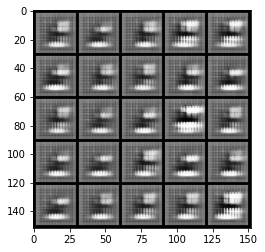

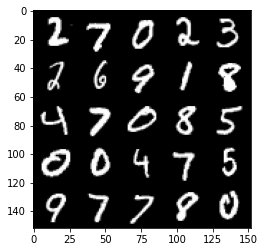

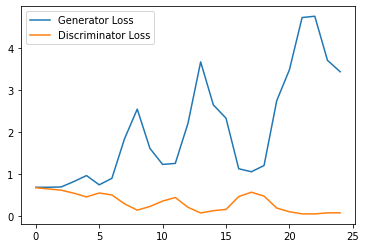

Step 1000: Generator loss: 3.4070387637615203, discriminator loss: 0.14726768317818642


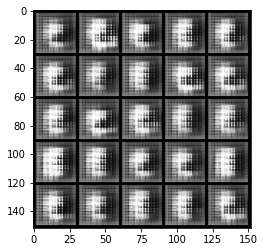

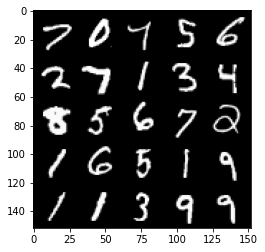

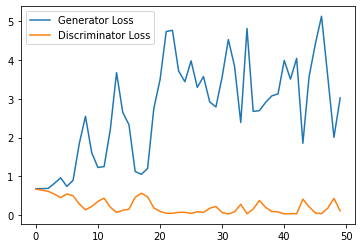

Step 1500: Generator loss: 4.021793174743652, discriminator loss: 0.11919708061218262


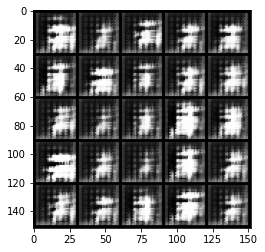

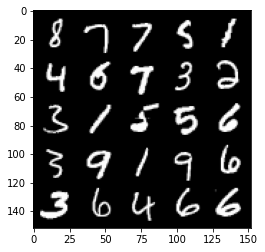

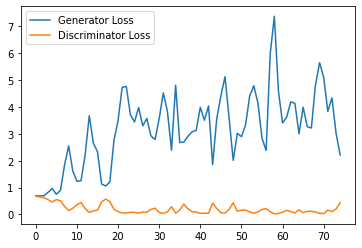

Step 2000: Generator loss: 3.9706971321105957, discriminator loss: 0.07522657249495387


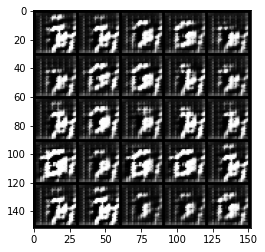

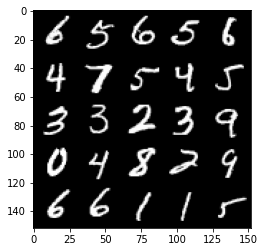

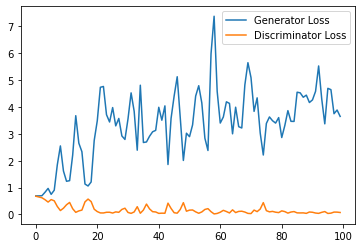

Step 2500: Generator loss: 3.2297979688644407, discriminator loss: 0.15538798352330924


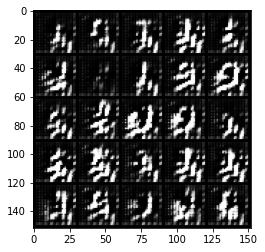

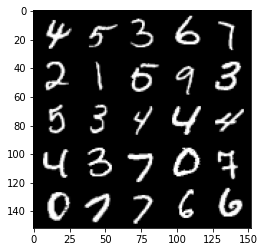

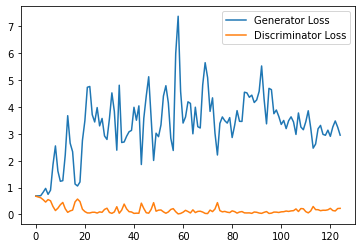

Step 3000: Generator loss: 2.5832101986408236, discriminator loss: 0.24402052846550942


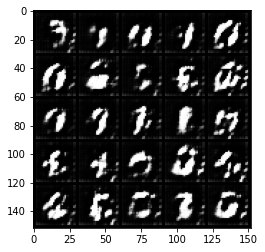

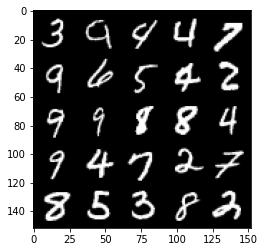

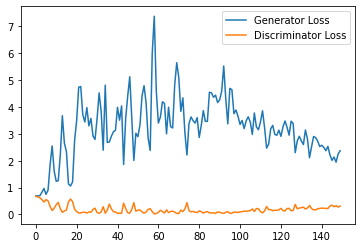

Step 3500: Generator loss: 1.9657993419170379, discriminator loss: 0.36550933891534804


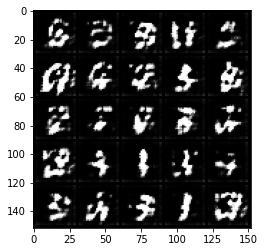

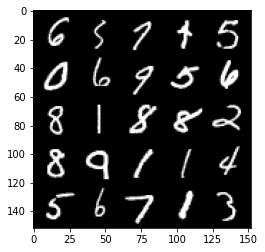

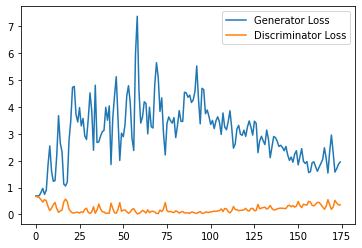

Step 4000: Generator loss: 1.9351991810798645, discriminator loss: 0.40776933065056803


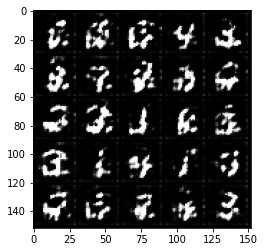

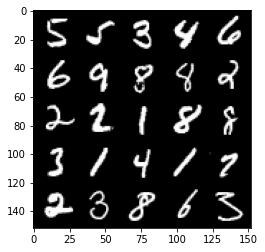

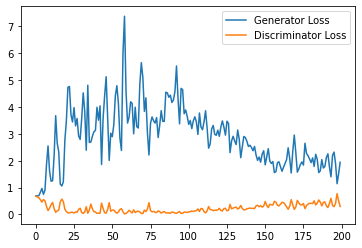

Step 4500: Generator loss: 1.7075075435638427, discriminator loss: 0.38044345706701277


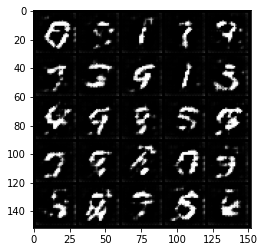

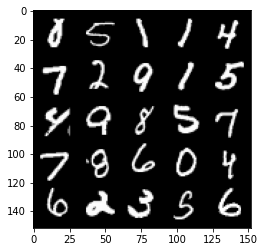

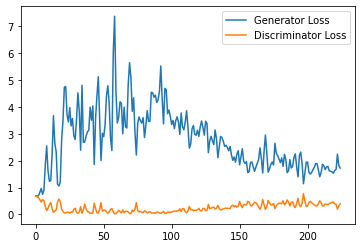

Step 5000: Generator loss: 1.795996728181839, discriminator loss: 0.41109474232792853


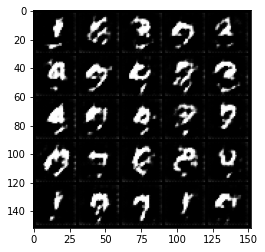

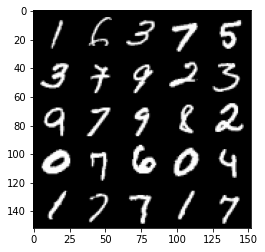

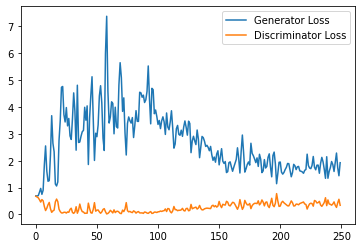

Step 5500: Generator loss: 1.7084953908920288, discriminator loss: 0.3694827368855476


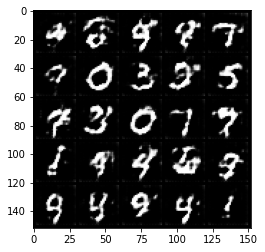

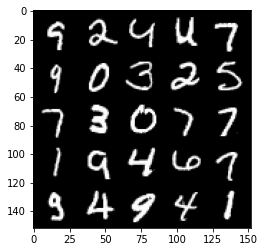

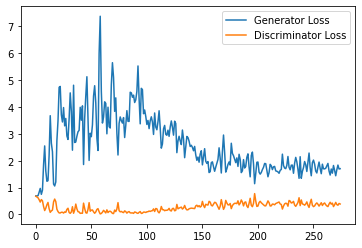

Step 6000: Generator loss: 1.6513792644739151, discriminator loss: 0.4172316997051239


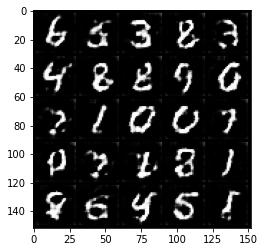

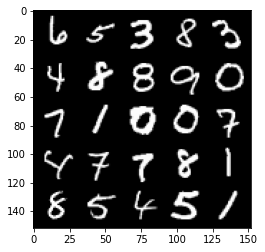

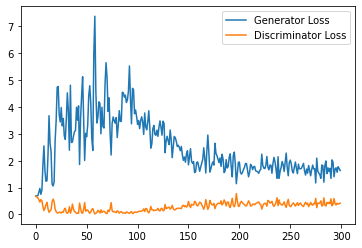

Step 6500: Generator loss: 1.5550615360736848, discriminator loss: 0.4293127876520157


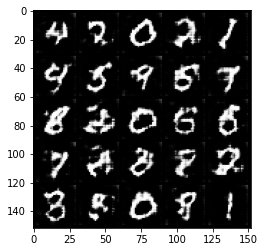

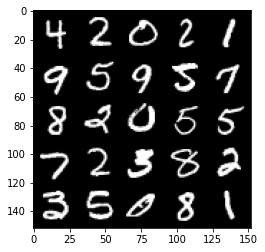

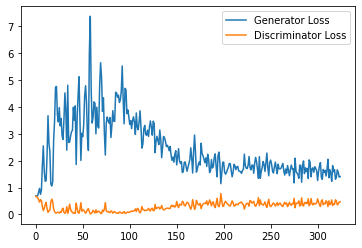

Step 7000: Generator loss: 1.570269460916519, discriminator loss: 0.45874544203281403


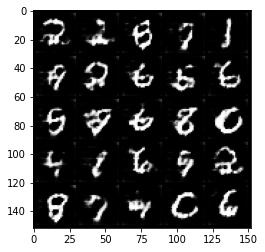

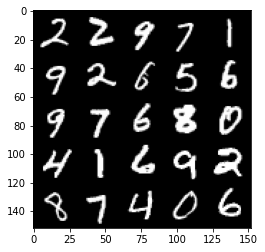

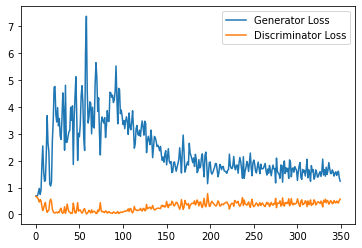

Step 7500: Generator loss: 1.3749207161664962, discriminator loss: 0.4836252338886261


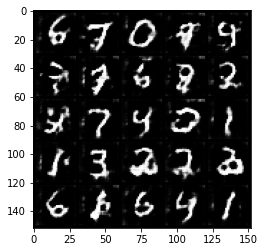

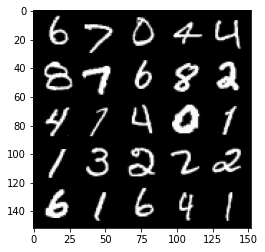

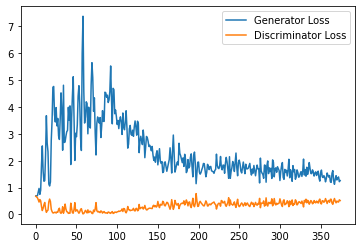

Step 8000: Generator loss: 1.3323942732810974, discriminator loss: 0.5053108361959457


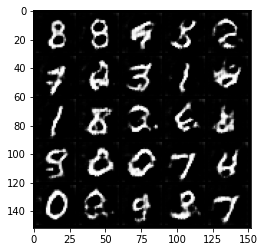

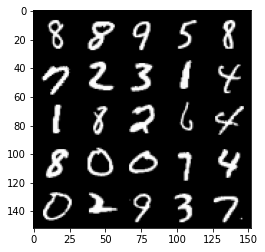

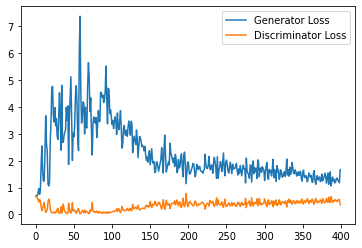

Step 8500: Generator loss: 1.2460517354011535, discriminator loss: 0.5255971503257751


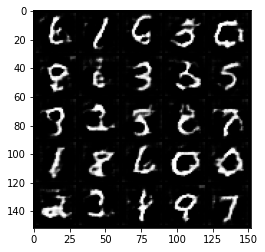

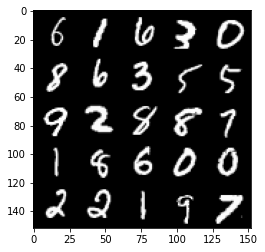

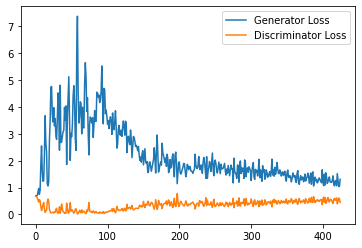

Step 9000: Generator loss: 1.161173284292221, discriminator loss: 0.5376096360683441


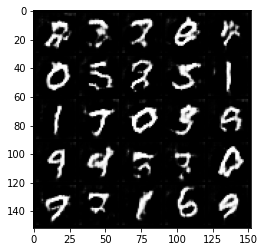

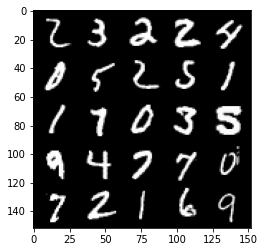

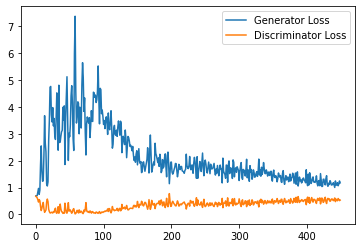

Step 9500: Generator loss: 1.2347626668214797, discriminator loss: 0.5425799921751022


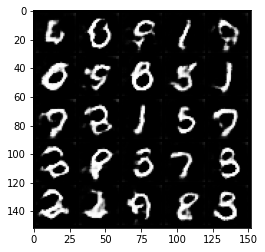

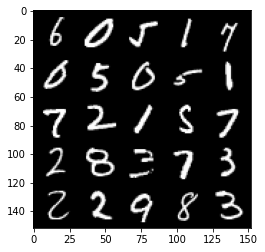

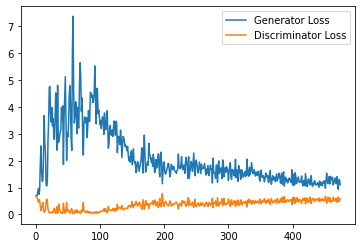

Step 10000: Generator loss: 1.1721925024986266, discriminator loss: 0.5685085289478302


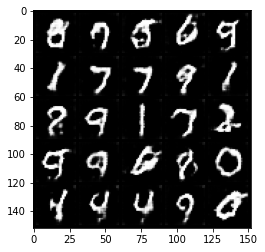

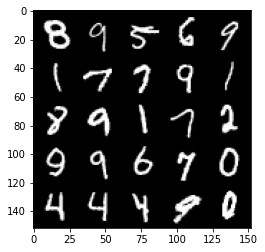

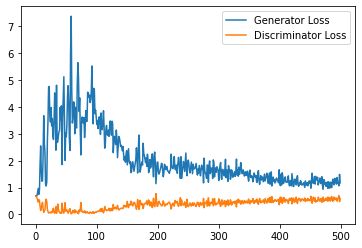

Step 10500: Generator loss: 1.171002894282341, discriminator loss: 0.555869978427887


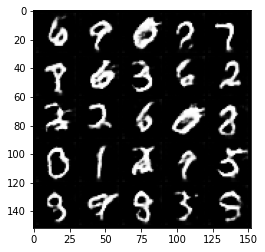

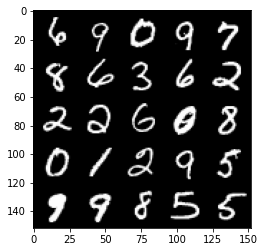

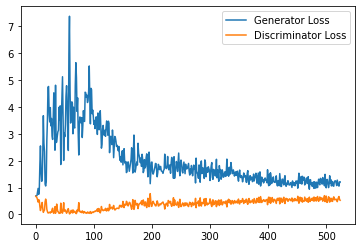

Step 11000: Generator loss: 1.1027329553365708, discriminator loss: 0.5642932459115982


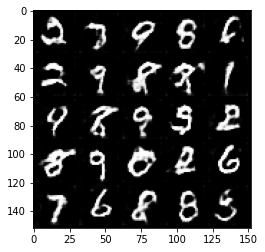

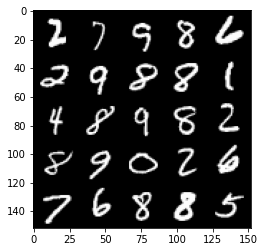

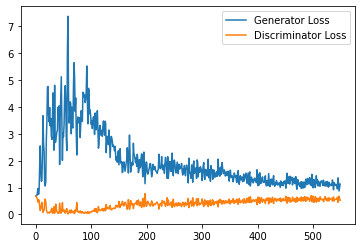

Step 11500: Generator loss: 1.0896215953826904, discriminator loss: 0.5615758357048035


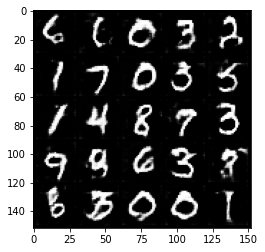

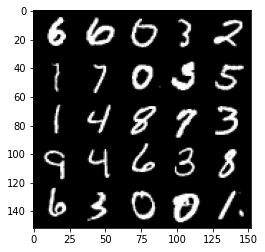

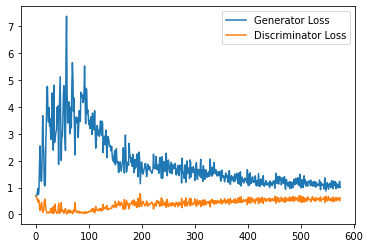

Step 12000: Generator loss: 1.0998252162933349, discriminator loss: 0.569090830028057


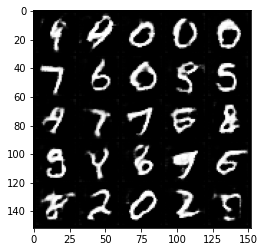

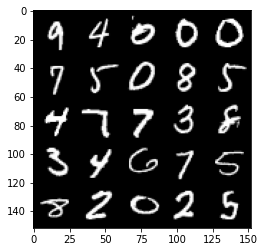

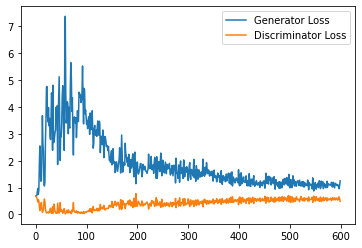

Step 12500: Generator loss: 1.077929164648056, discriminator loss: 0.5787792564034462


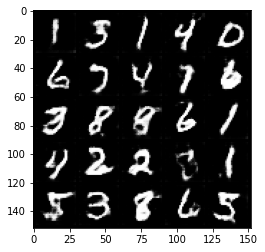

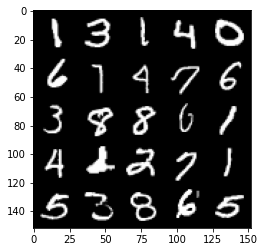

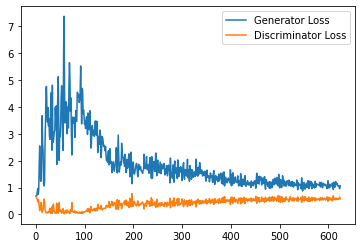

Step 13000: Generator loss: 1.049649803519249, discriminator loss: 0.5762882885932923


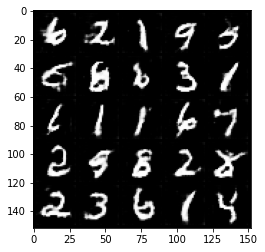

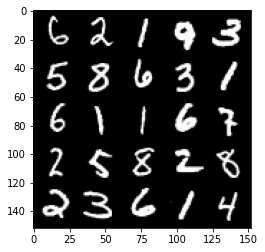

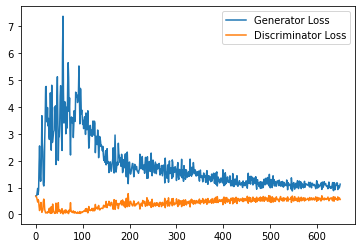

Step 13500: Generator loss: 1.0786205596923828, discriminator loss: 0.5823828674554825


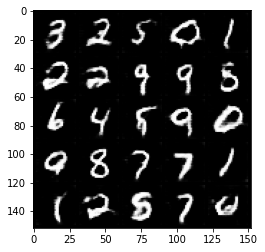

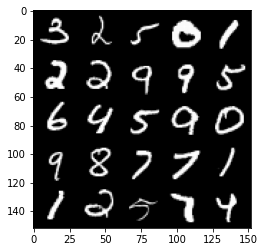

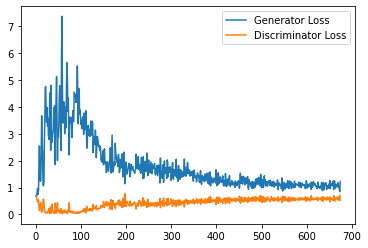

Step 14000: Generator loss: 1.062897258877754, discriminator loss: 0.5882771027088165


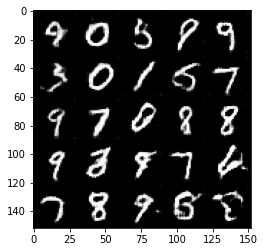

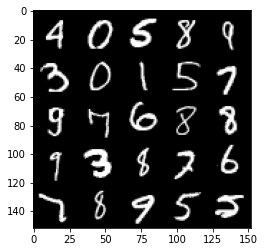

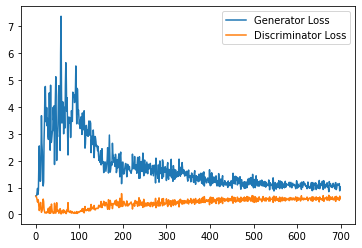

Step 14500: Generator loss: 1.0428105627298354, discriminator loss: 0.5958762526512146


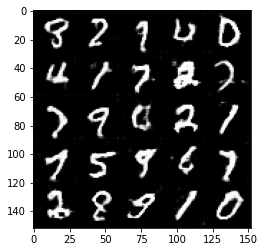

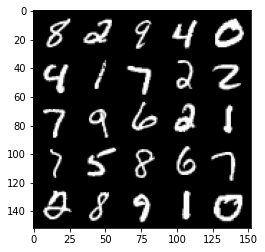

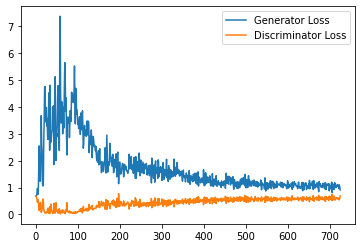

Step 15000: Generator loss: 1.001330716729164, discriminator loss: 0.601721478819847


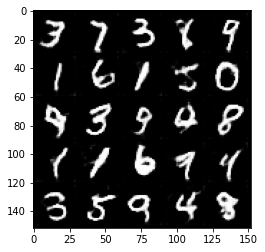

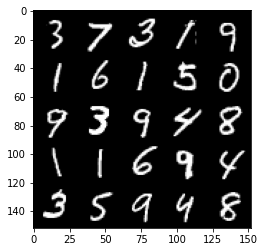

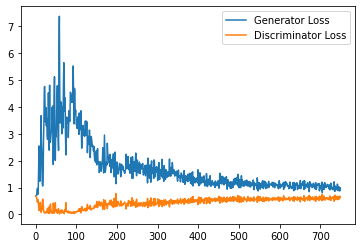

Step 15500: Generator loss: 1.007197778582573, discriminator loss: 0.5929022015333175


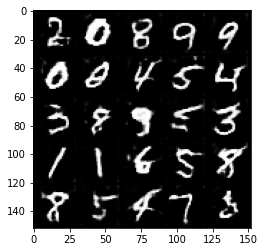

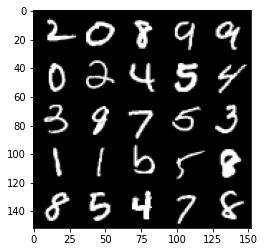

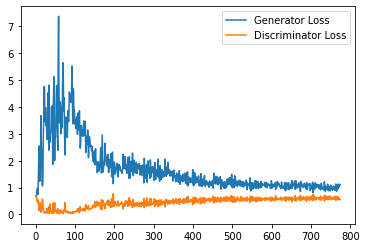

Step 16000: Generator loss: 1.019473795413971, discriminator loss: 0.6040123353004455


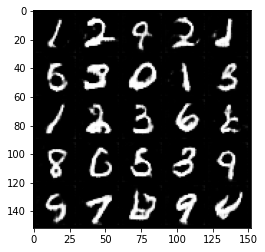

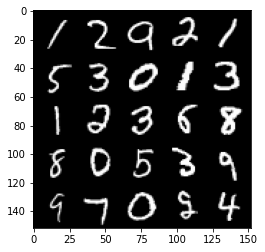

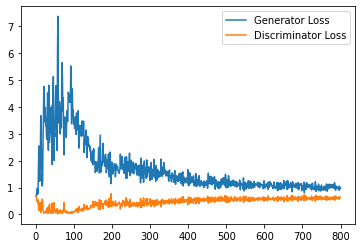

Step 16500: Generator loss: 1.0020167343616486, discriminator loss: 0.6075736692547798


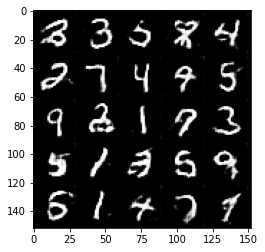

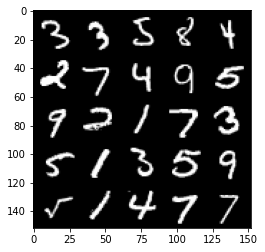

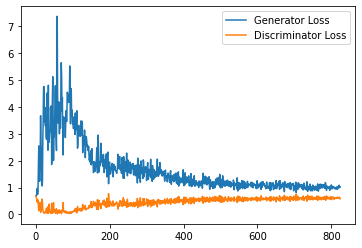

Step 17000: Generator loss: 0.9991205885410309, discriminator loss: 0.6152528001070022


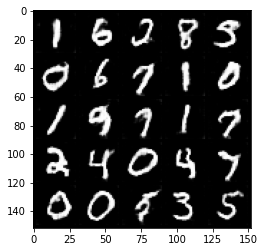

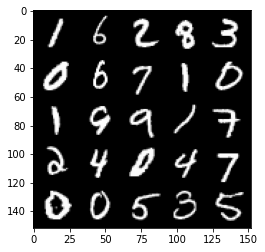

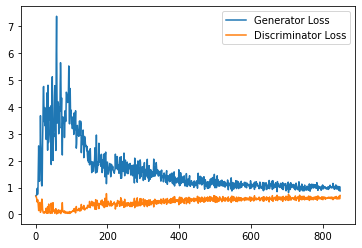

Step 17500: Generator loss: 0.9853573762178421, discriminator loss: 0.608659616291523


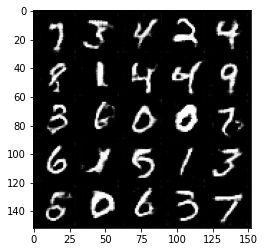

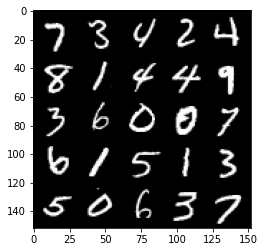

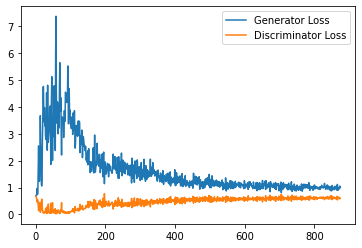

Step 18000: Generator loss: 0.9755685266256332, discriminator loss: 0.6109616951942444


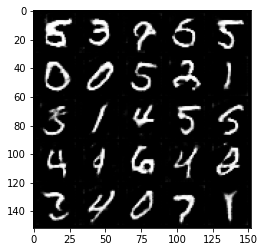

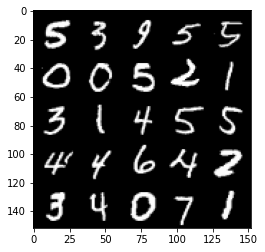

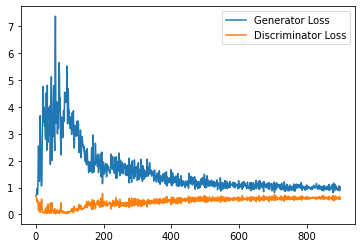

Step 18500: Generator loss: 0.9962513629198074, discriminator loss: 0.6147918739914894


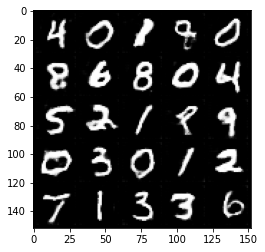

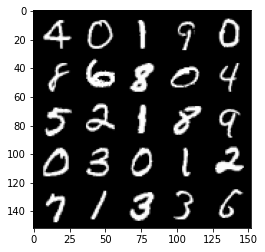

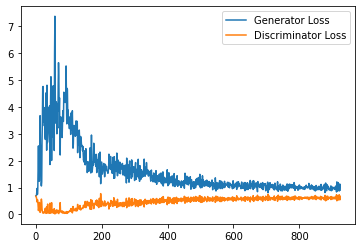

Step 19000: Generator loss: 0.9429348554611207, discriminator loss: 0.6206482285857201


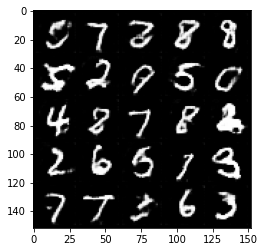

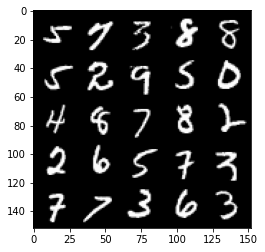

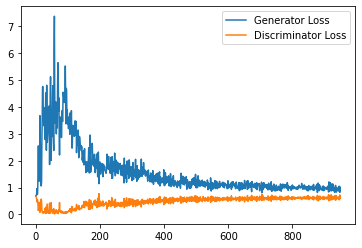

Step 19500: Generator loss: 0.9674392980337143, discriminator loss: 0.6147126810550689


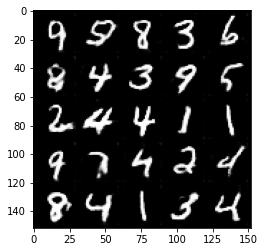

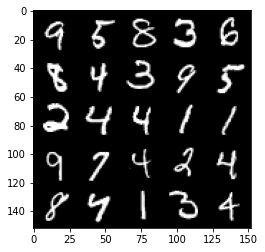

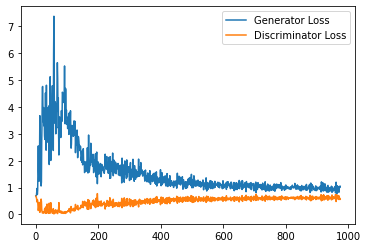

Step 20000: Generator loss: 0.942466943025589, discriminator loss: 0.6234388983845711


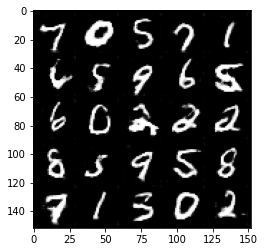

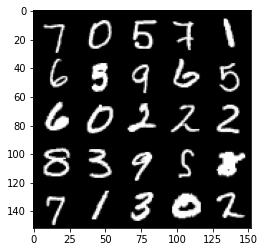

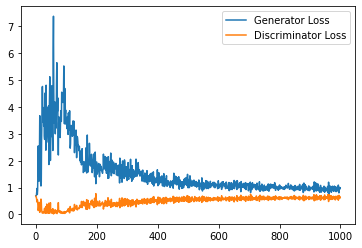

Step 20500: Generator loss: 0.942726176738739, discriminator loss: 0.6172164752483368


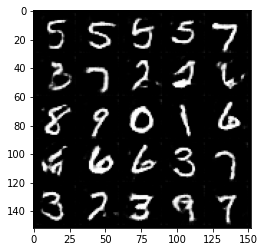

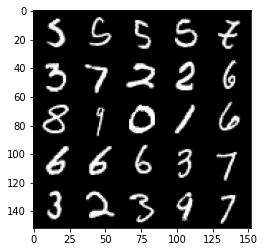

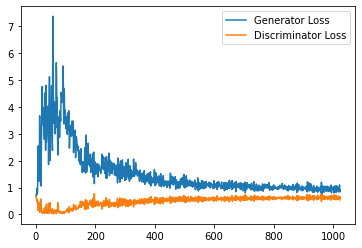

Step 21000: Generator loss: 0.9337200373411179, discriminator loss: 0.6201532343029976


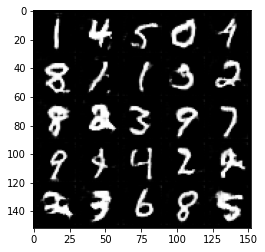

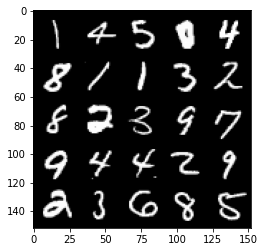

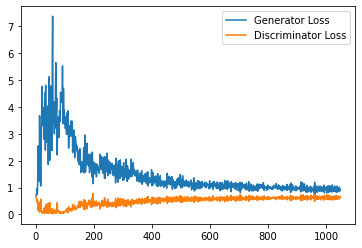

Step 21500: Generator loss: 0.9412829250097274, discriminator loss: 0.618541839003563


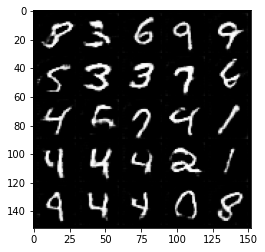

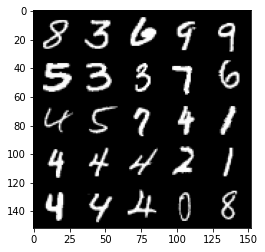

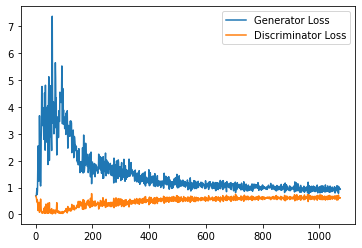

Step 22000: Generator loss: 0.9598764675855637, discriminator loss: 0.6170940178632737


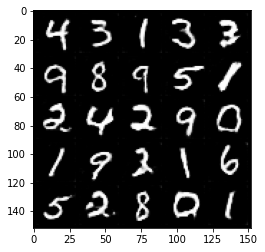

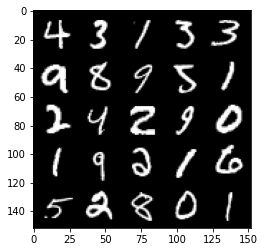

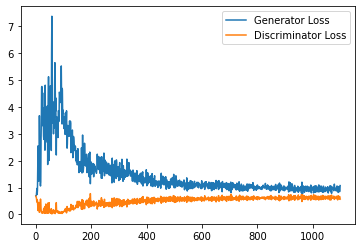

Step 22500: Generator loss: 0.9371810106039047, discriminator loss: 0.6270920906066895


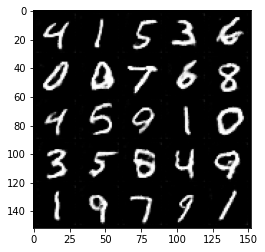

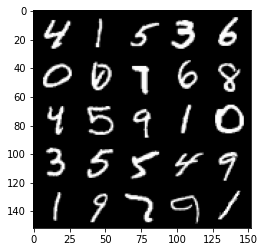

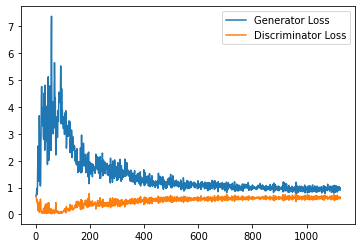

Step 23000: Generator loss: 0.9192716330289841, discriminator loss: 0.6228926372528076


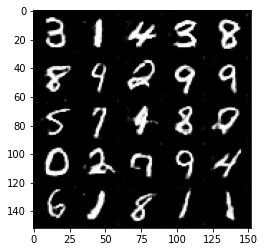

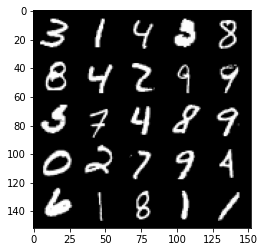

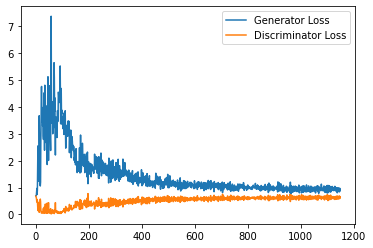

Step 23500: Generator loss: 0.949300374507904, discriminator loss: 0.624989911556244


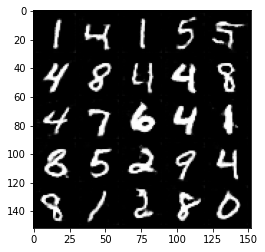

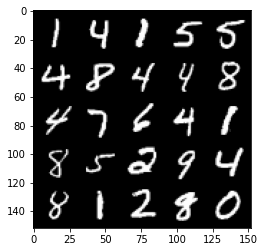

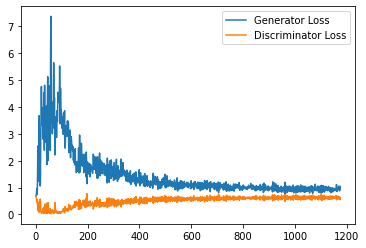

Step 24000: Generator loss: 0.9299510926008224, discriminator loss: 0.6264667563438415


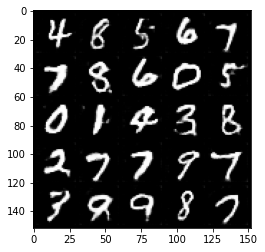

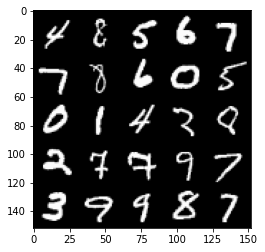

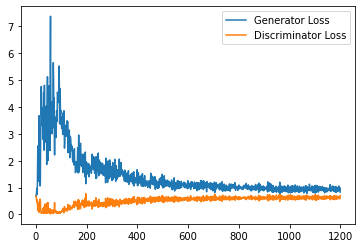

Step 24500: Generator loss: 0.9099525525569916, discriminator loss: 0.629333464384079


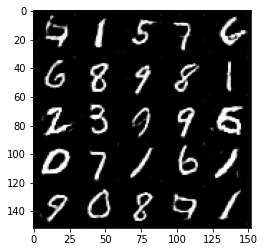

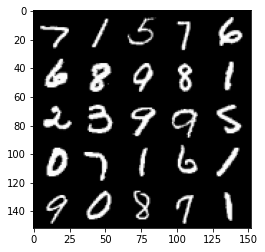

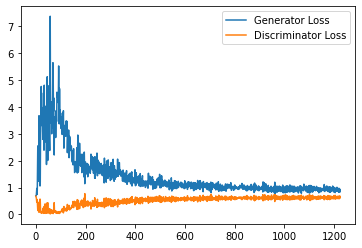

Step 25000: Generator loss: 0.916190898180008, discriminator loss: 0.6223767414093018


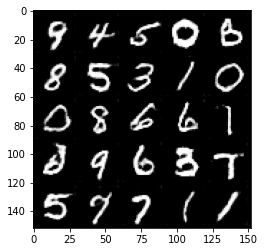

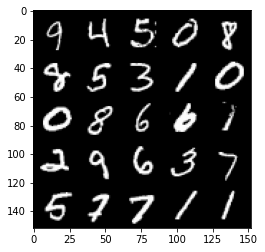

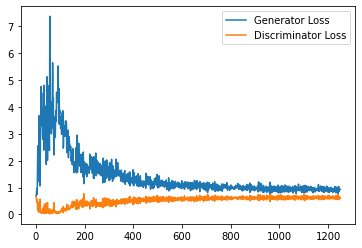

Step 25500: Generator loss: 0.9126185909509659, discriminator loss: 0.6309600536823272


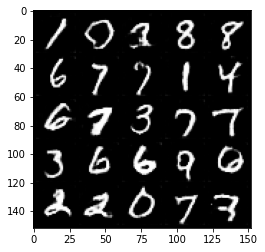

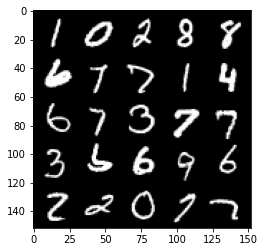

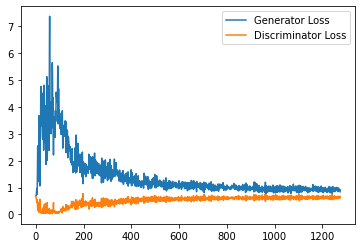

Step 26000: Generator loss: 0.9004902960062027, discriminator loss: 0.6299526419639587


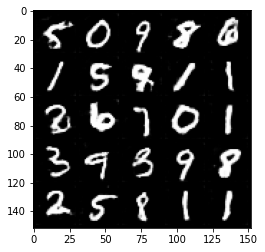

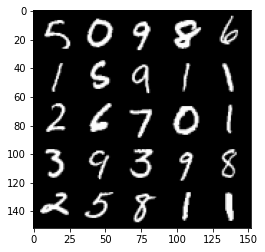

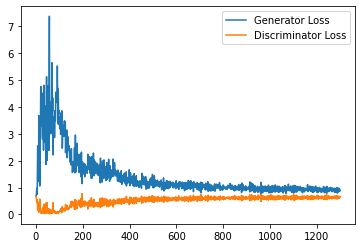

Step 26500: Generator loss: 0.9168501033782959, discriminator loss: 0.6255433579087257


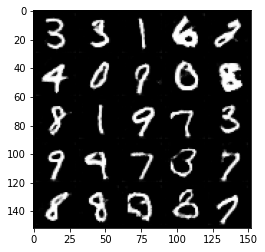

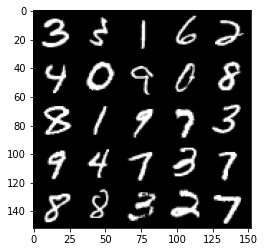

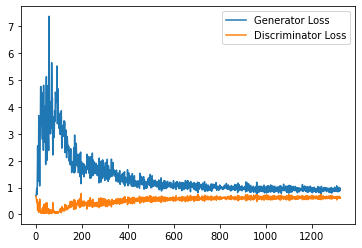

Step 27000: Generator loss: 0.928235233426094, discriminator loss: 0.6223068096637726


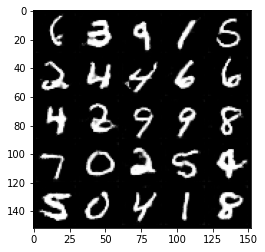

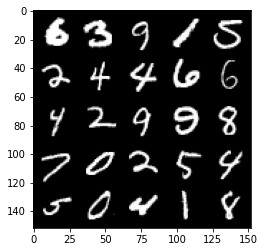

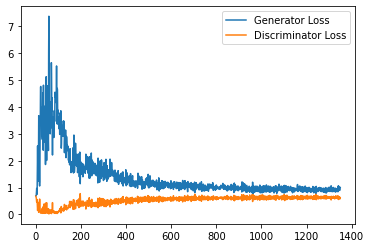

Step 27500: Generator loss: 0.9049079352617264, discriminator loss: 0.6281548504829406


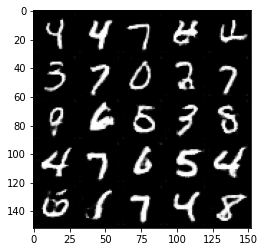

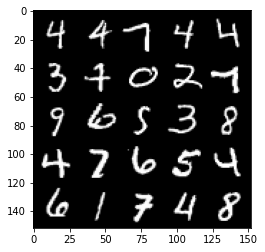

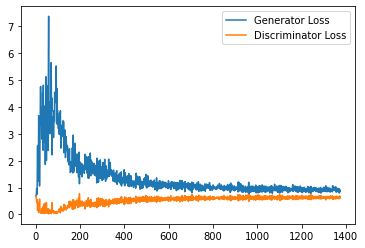

Step 28000: Generator loss: 0.8986856982707977, discriminator loss: 0.6254178982377052


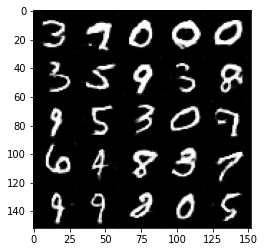

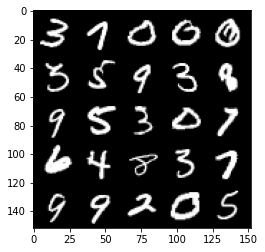

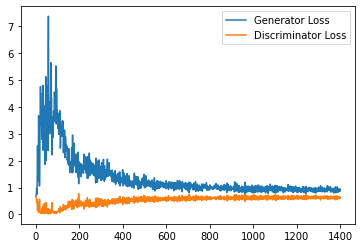

Step 28500: Generator loss: 0.9256138937473297, discriminator loss: 0.625759967982769


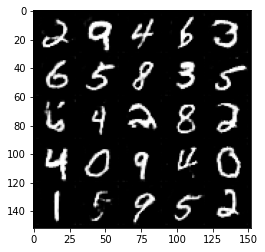

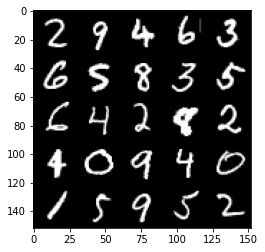

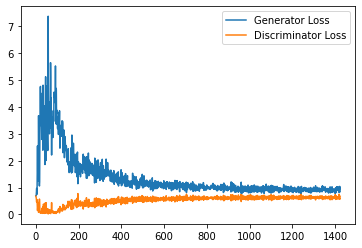

Step 29000: Generator loss: 0.902096550822258, discriminator loss: 0.6292735192775726


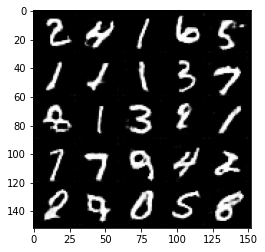

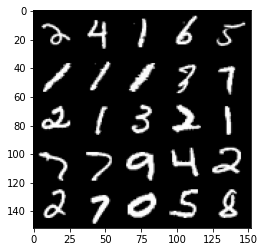

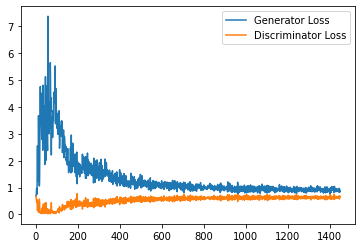

Step 29500: Generator loss: 0.8997988739013671, discriminator loss: 0.6247689605951309


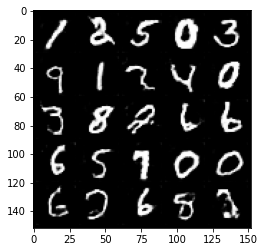

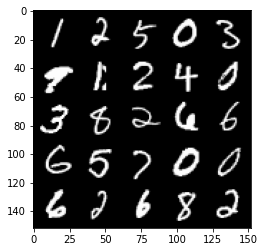

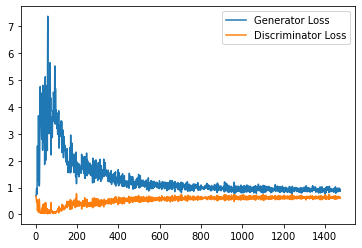

Step 30000: Generator loss: 0.9242736647129058, discriminator loss: 0.6277941497564316


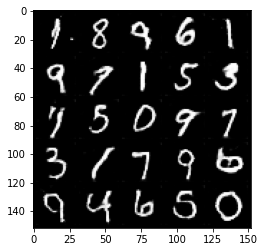

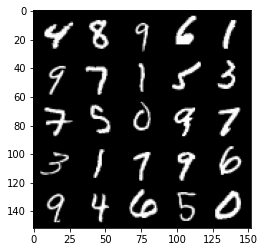

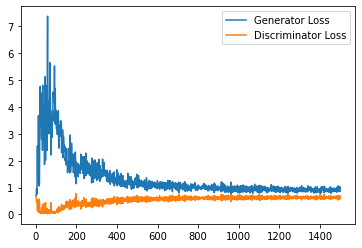

Step 30500: Generator loss: 0.9045241318941116, discriminator loss: 0.62586703145504


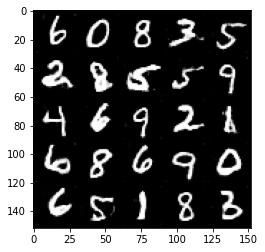

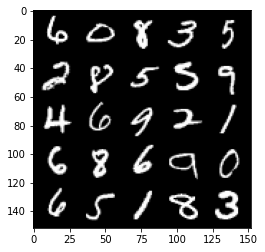

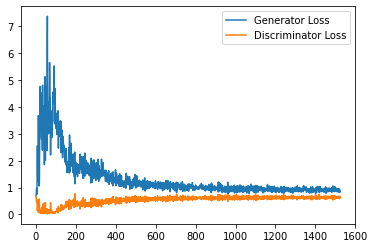

Step 31000: Generator loss: 0.9033047053813934, discriminator loss: 0.6233040473461151


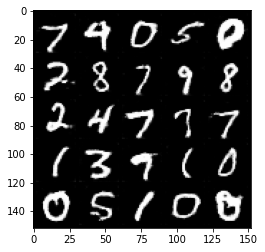

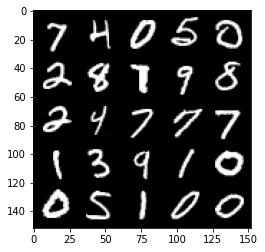

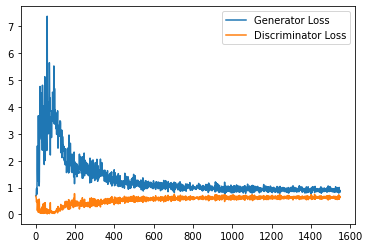

Step 31500: Generator loss: 0.9077819484472275, discriminator loss: 0.6281960908174514


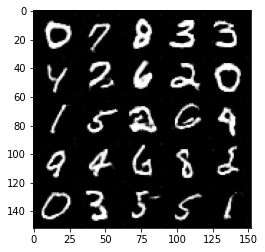

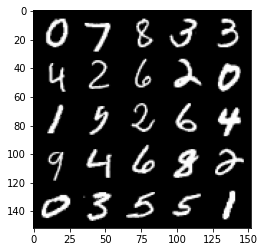

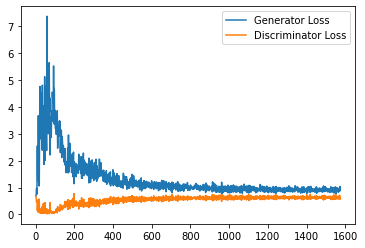

Step 32000: Generator loss: 0.896870450258255, discriminator loss: 0.6304837299585342


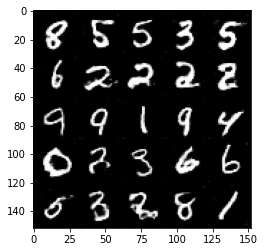

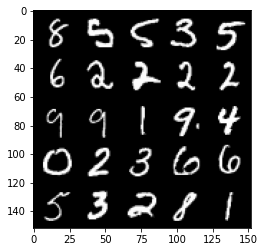

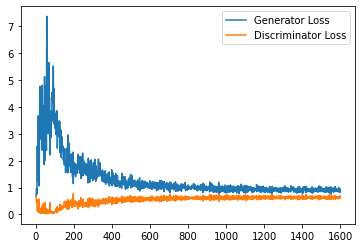

Step 32500: Generator loss: 0.9102703003883362, discriminator loss: 0.6272400780320168


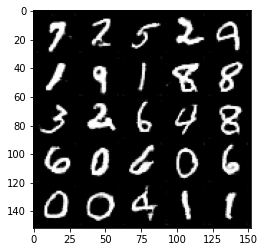

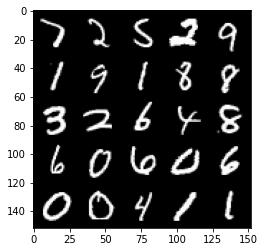

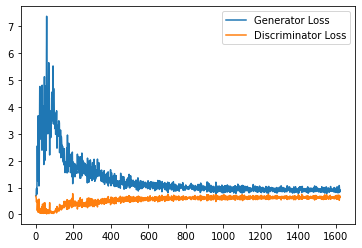

Step 33000: Generator loss: 0.9105726739168167, discriminator loss: 0.6240535963177681


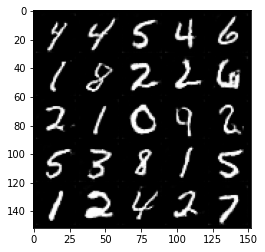

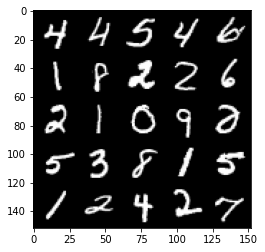

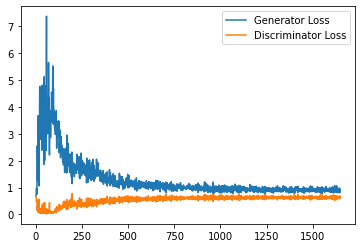

Step 33500: Generator loss: 0.904085211277008, discriminator loss: 0.6235552399158478


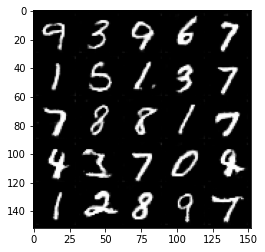

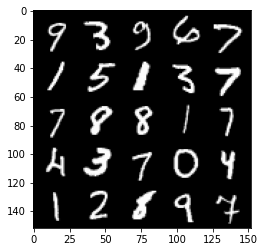

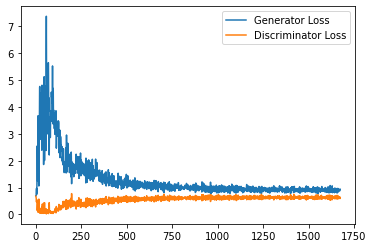

Step 34000: Generator loss: 0.896960862159729, discriminator loss: 0.6259217627048492


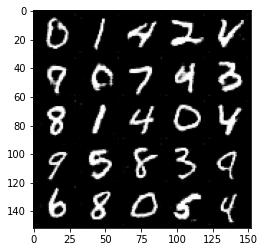

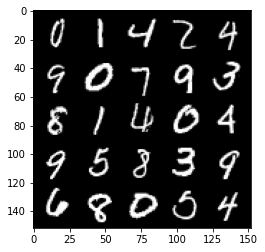

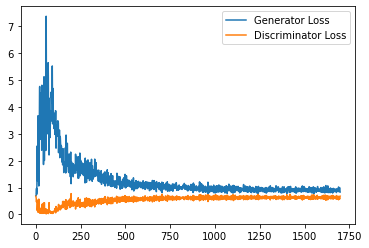

Step 34500: Generator loss: 0.9110174796581268, discriminator loss: 0.6194839900732041


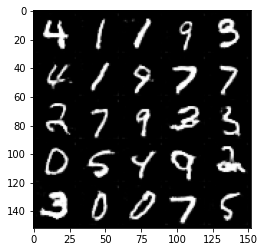

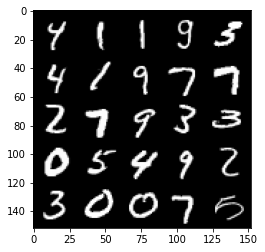

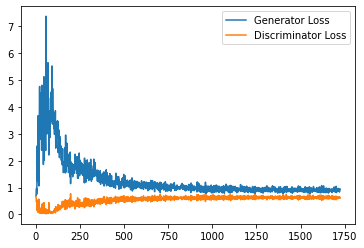

Step 35000: Generator loss: 0.9178684160709382, discriminator loss: 0.6187921226620674


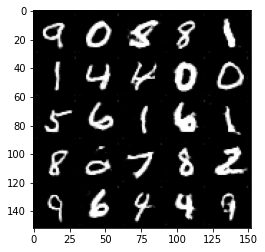

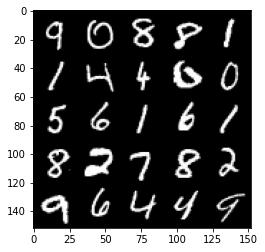

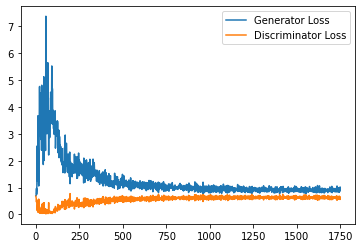

Step 35500: Generator loss: 0.921814125418663, discriminator loss: 0.626208800971508


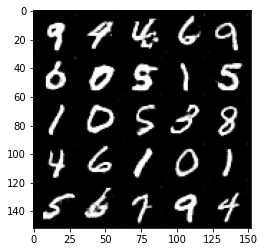

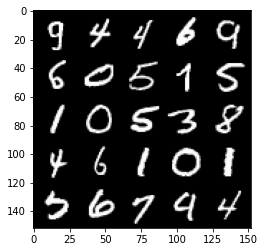

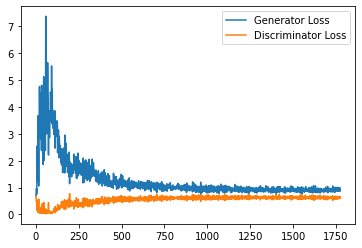

Step 36000: Generator loss: 0.9129603662490845, discriminator loss: 0.6211442902684212


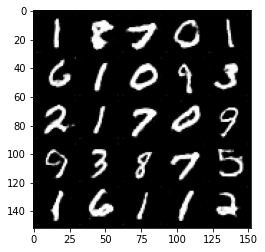

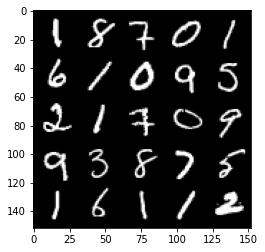

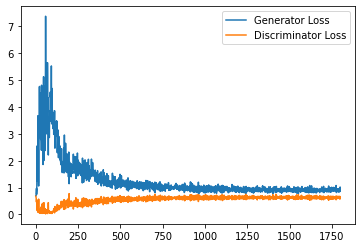

Step 36500: Generator loss: 0.9010227471590042, discriminator loss: 0.6200248390436173


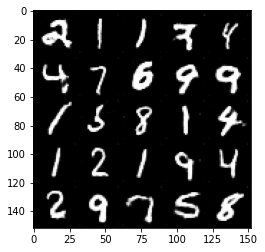

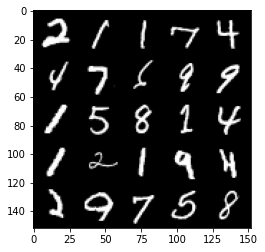

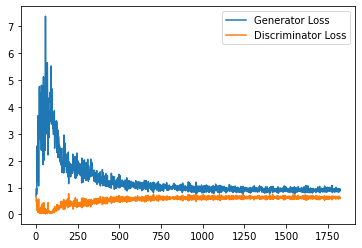

Step 37000: Generator loss: 0.9102282149791717, discriminator loss: 0.6211254402399063


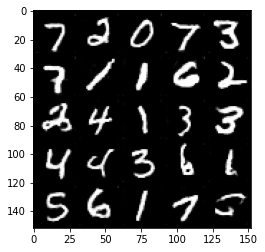

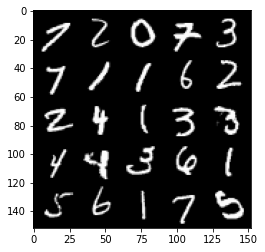

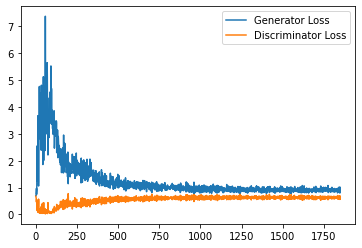

Step 37500: Generator loss: 0.9267893506288528, discriminator loss: 0.6200849250555038


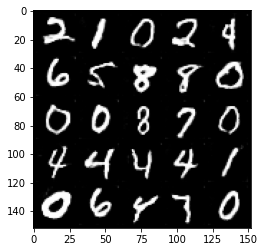

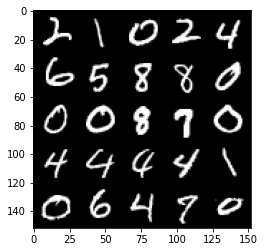

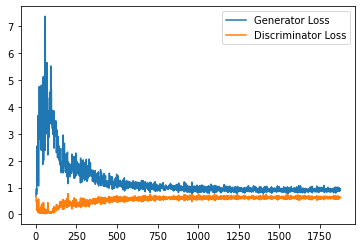

Step 38000: Generator loss: 0.9264603949785233, discriminator loss: 0.6185111600160599


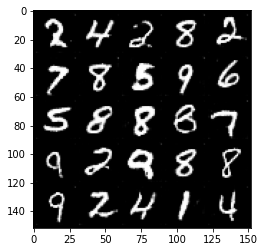

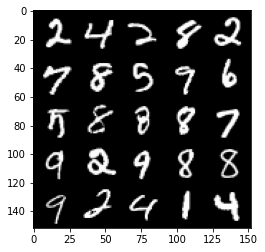

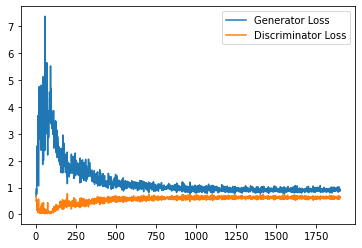

Step 38500: Generator loss: 0.9238145372867584, discriminator loss: 0.6221360104084015


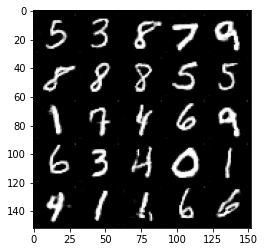

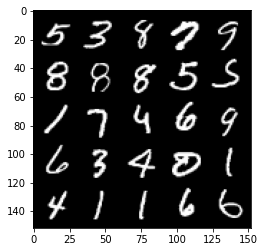

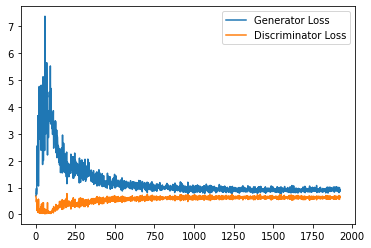

Step 39000: Generator loss: 0.9238573484420777, discriminator loss: 0.6175399889349937


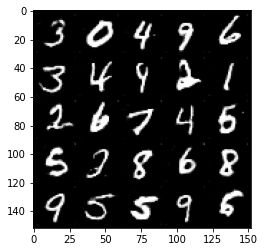

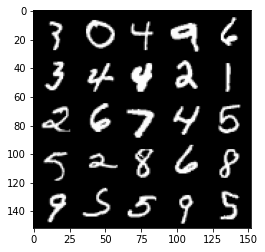

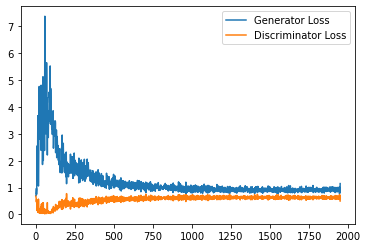

Step 39500: Generator loss: 0.9062979962825776, discriminator loss: 0.6201524561643601


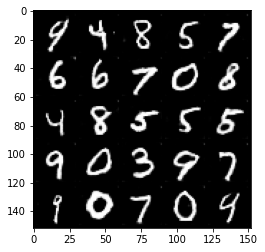

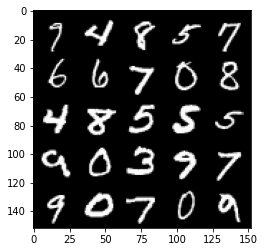

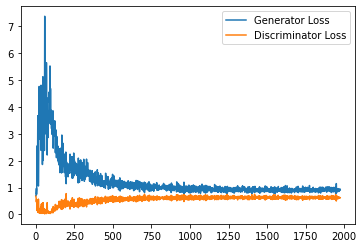

Step 40000: Generator loss: 0.9144534634351731, discriminator loss: 0.6168214837312699


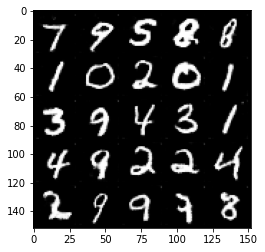

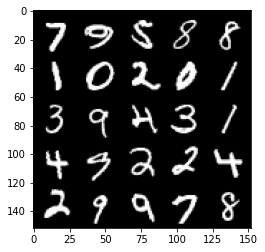

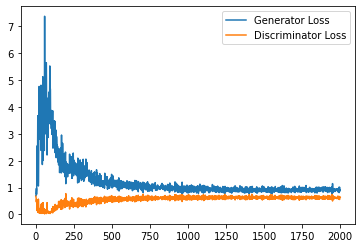

Step 40500: Generator loss: 0.9397800931930542, discriminator loss: 0.6106682393550873


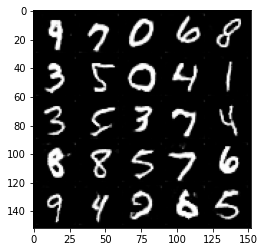

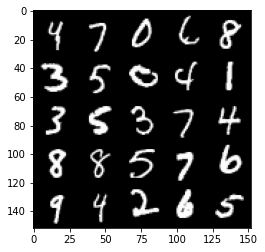

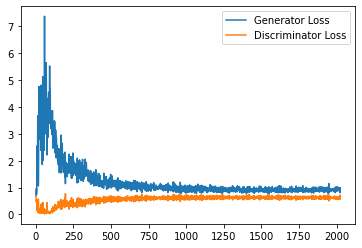

Step 41000: Generator loss: 0.9149930731058121, discriminator loss: 0.6139657359719276


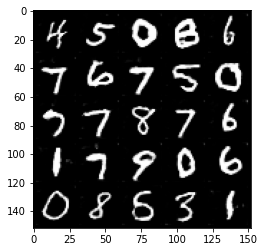

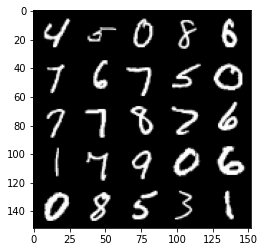

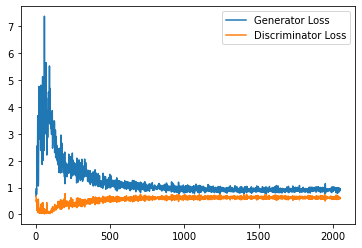

Step 41500: Generator loss: 0.9054663672447204, discriminator loss: 0.6168320716619492


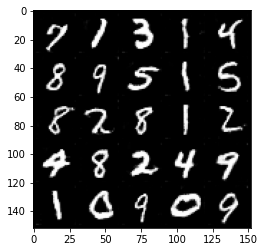

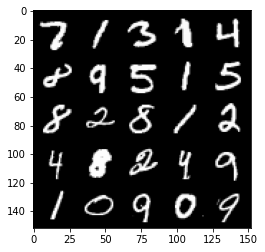

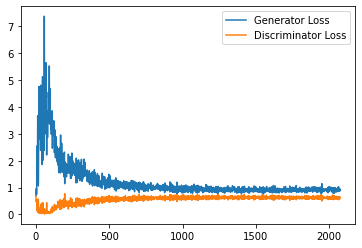

Step 42000: Generator loss: 0.9433007582426071, discriminator loss: 0.6119623561501503


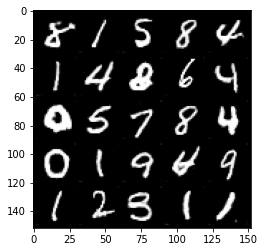

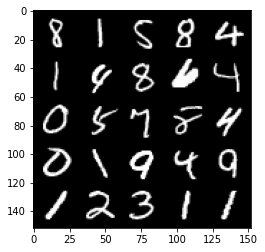

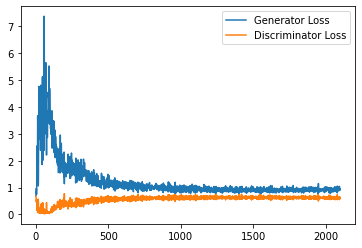

Step 42500: Generator loss: 0.9292165575027466, discriminator loss: 0.6134012244939804


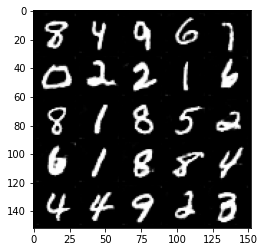

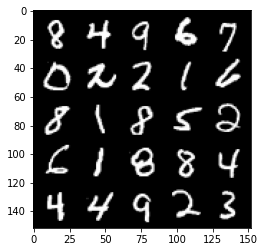

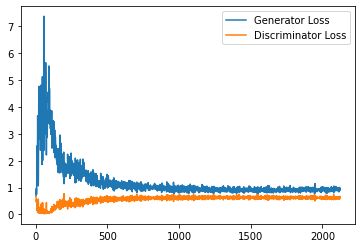

Step 43000: Generator loss: 0.9397691121101379, discriminator loss: 0.6104351581335068


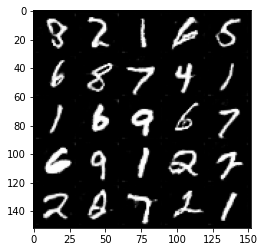

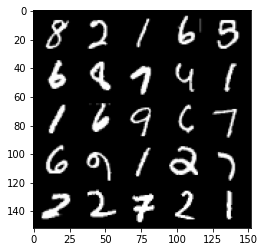

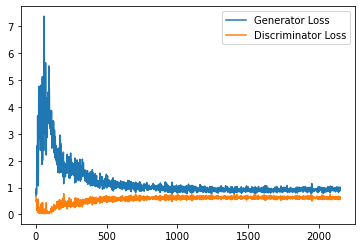

Step 43500: Generator loss: 0.9250647004842758, discriminator loss: 0.6150500503182411


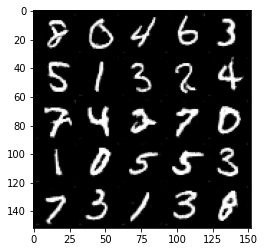

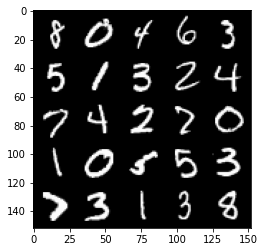

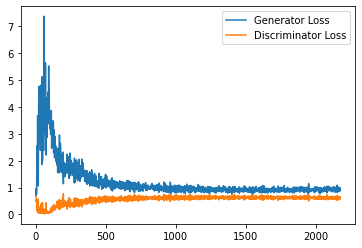

Step 44000: Generator loss: 0.9286709779500961, discriminator loss: 0.6102960253953934


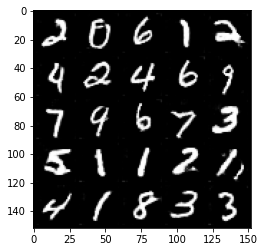

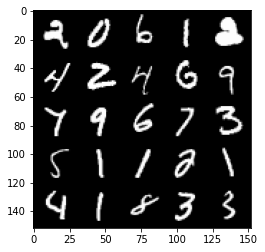

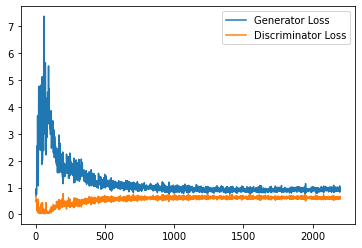

Step 44500: Generator loss: 0.920532988190651, discriminator loss: 0.6126644392609596


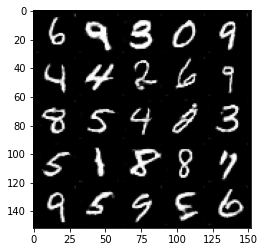

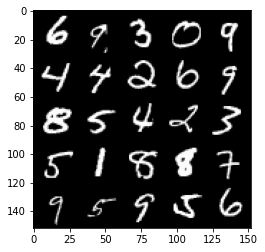

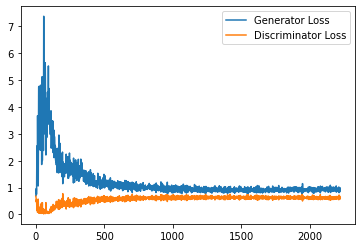

Step 45000: Generator loss: 0.9490764534473419, discriminator loss: 0.613253743827343


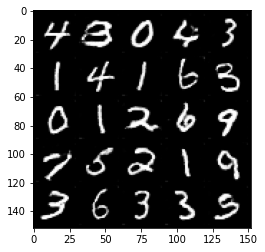

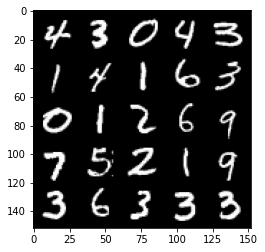

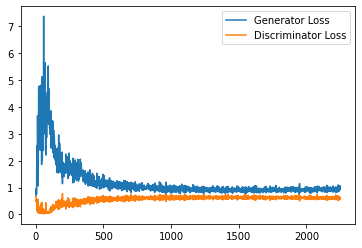

Step 45500: Generator loss: 0.9432805519104004, discriminator loss: 0.6098874768018723


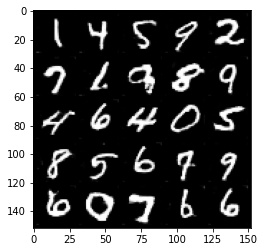

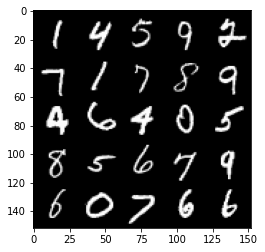

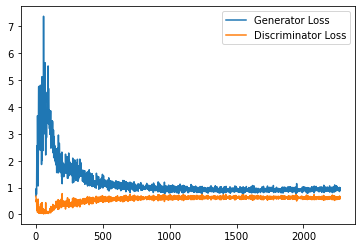

Step 46000: Generator loss: 0.9445383175611496, discriminator loss: 0.6103059048056603


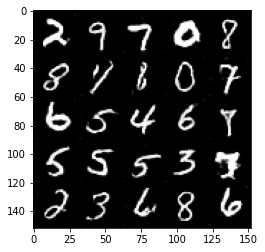

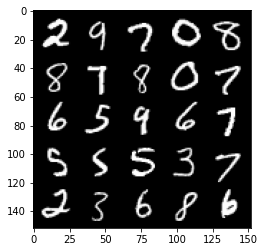

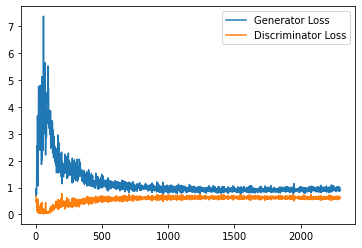

Step 46500: Generator loss: 0.9370279772281647, discriminator loss: 0.6060737268924713


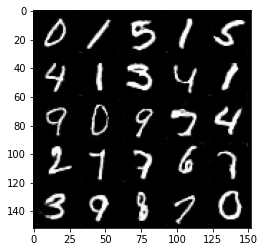

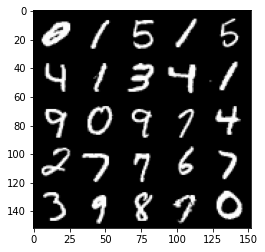

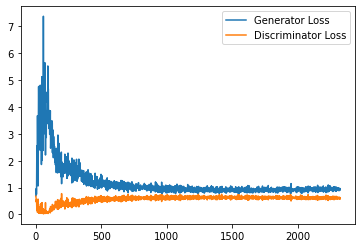

Step 47000: Generator loss: 0.9287138837575912, discriminator loss: 0.6106675869226456


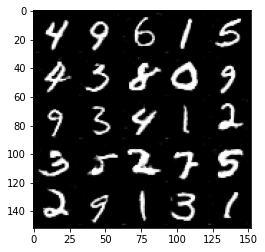

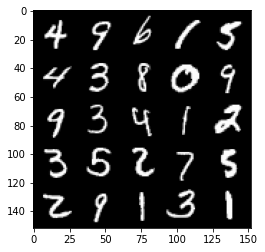

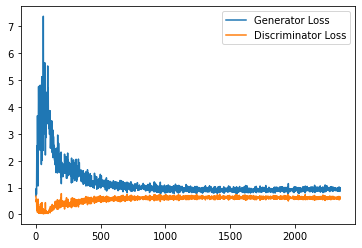

Step 47500: Generator loss: 0.9426012629270554, discriminator loss: 0.6099837739467621


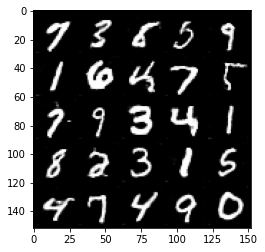

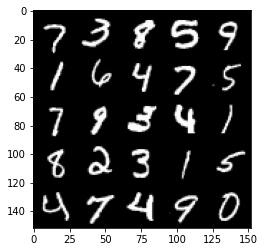

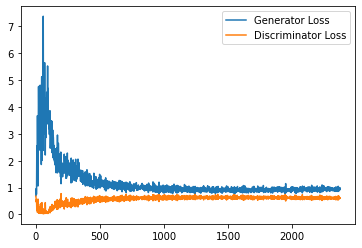

Step 48000: Generator loss: 0.9331383267641068, discriminator loss: 0.6150733519196511


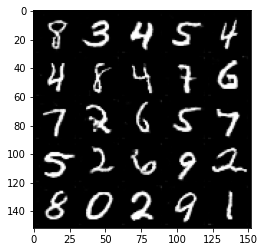

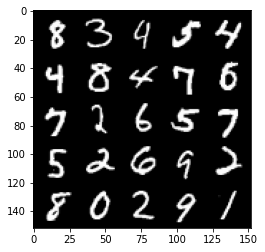

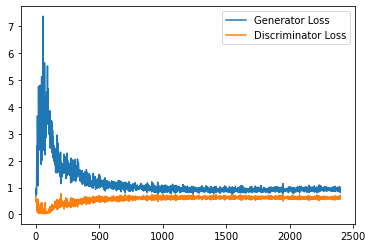

Step 48500: Generator loss: 0.9446958035230637, discriminator loss: 0.6063366360068321


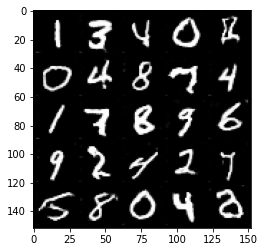

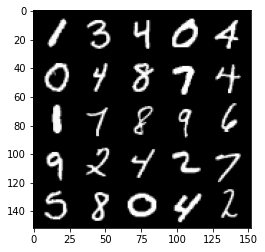

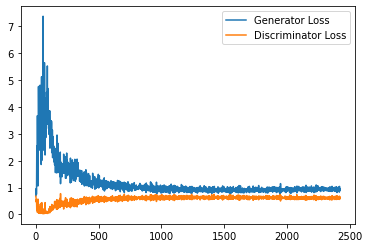

Step 49000: Generator loss: 0.9425904372930527, discriminator loss: 0.6124225674271584


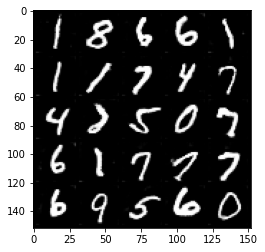

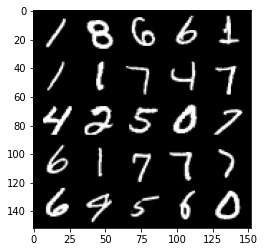

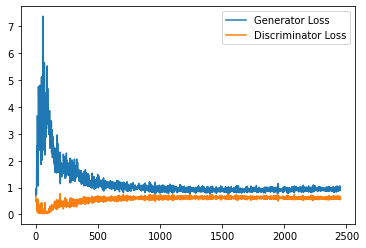

Step 49500: Generator loss: 0.9498528881072998, discriminator loss: 0.6076397715210915


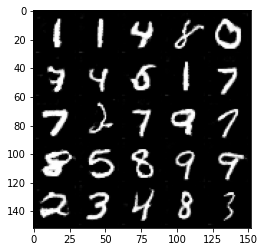

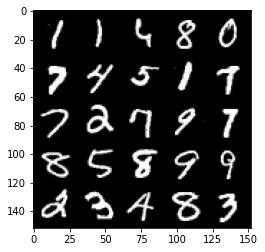

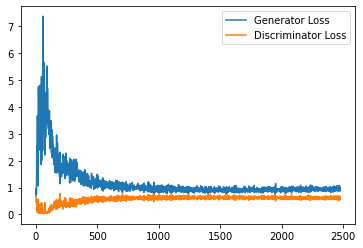

Step 50000: Generator loss: 0.9361748569011689, discriminator loss: 0.6122675045132637


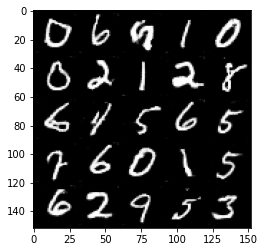

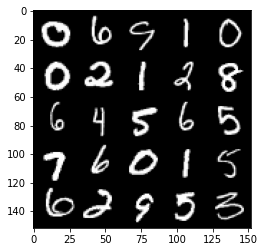

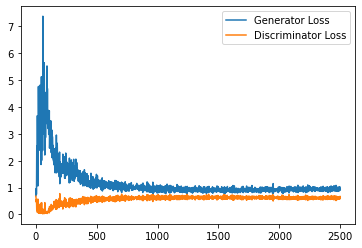

Step 50500: Generator loss: 0.9416576997041702, discriminator loss: 0.6028943187594413


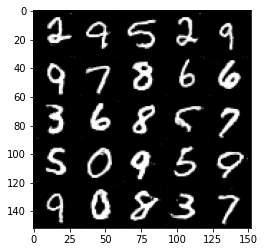

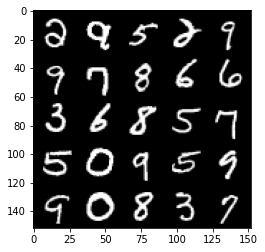

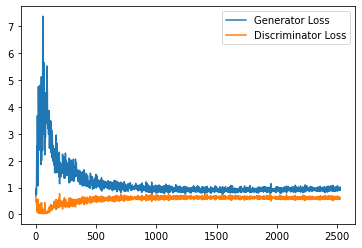

Step 51000: Generator loss: 0.9449539259672165, discriminator loss: 0.6104712973833084


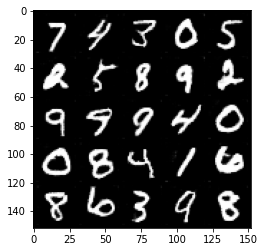

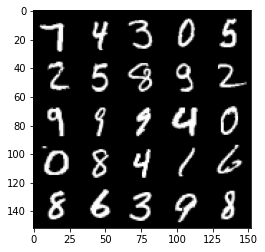

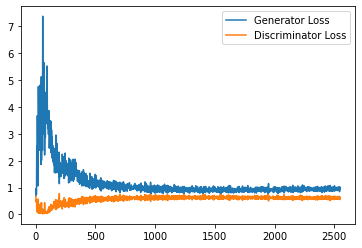

Step 51500: Generator loss: 0.952846777677536, discriminator loss: 0.6048128472566605


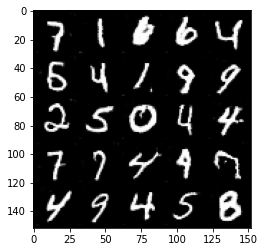

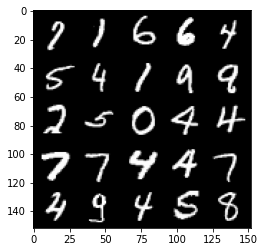

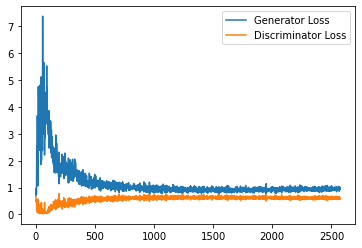

Step 52000: Generator loss: 0.9544414390325546, discriminator loss: 0.6075625049471856


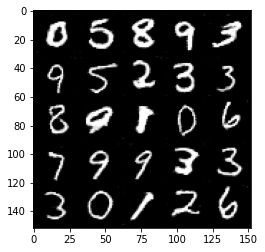

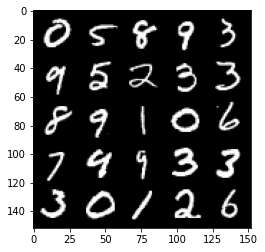

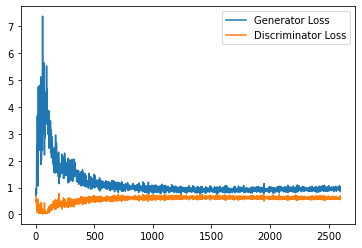

Step 52500: Generator loss: 0.9507275129556656, discriminator loss: 0.6031719421744347


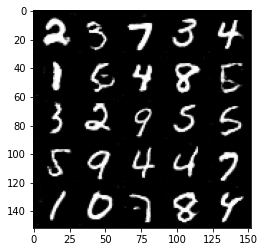

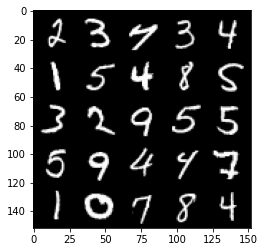

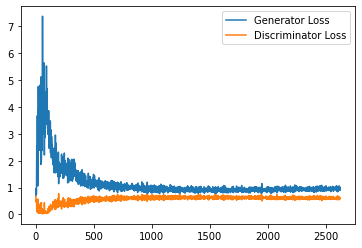

Step 53000: Generator loss: 0.9429437557458877, discriminator loss: 0.6038608371019364


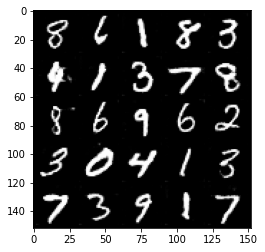

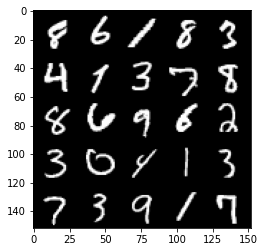

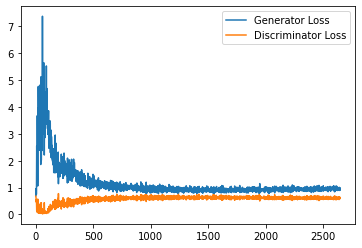

Step 53500: Generator loss: 0.9538724186420441, discriminator loss: 0.6067612979412079


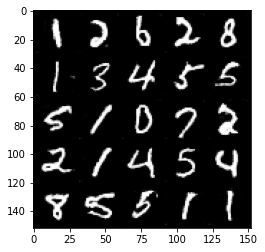

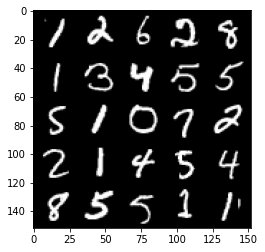

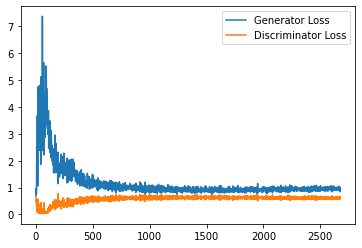

Step 54000: Generator loss: 0.9712468044757843, discriminator loss: 0.6011588007807732


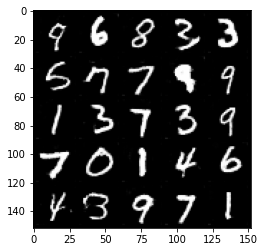

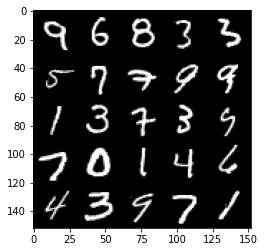

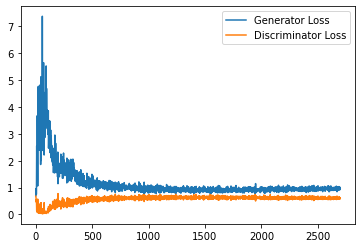

Step 54500: Generator loss: 0.9537551803588867, discriminator loss: 0.6054154580235481


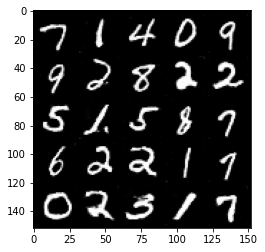

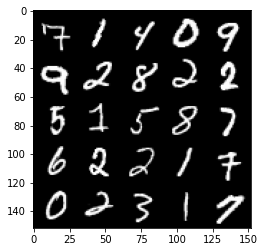

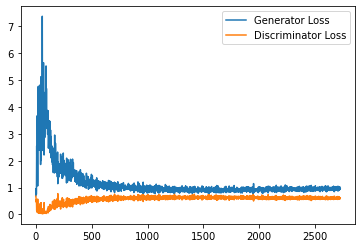

Step 55000: Generator loss: 0.9508688657283783, discriminator loss: 0.604876968383789


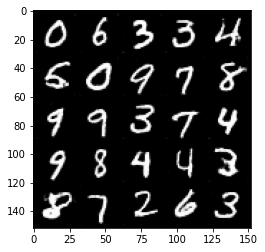

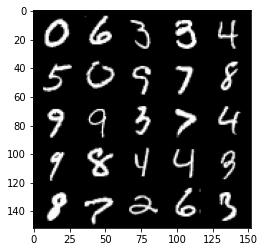

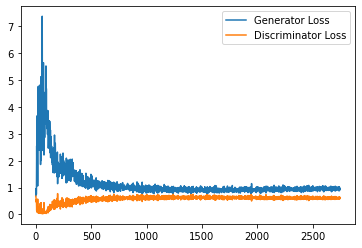

Step 55500: Generator loss: 0.938035765171051, discriminator loss: 0.6058817697763443


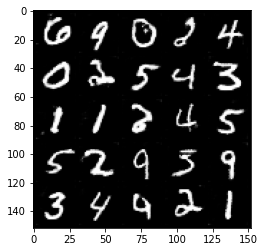

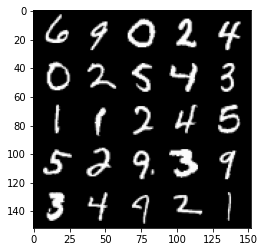

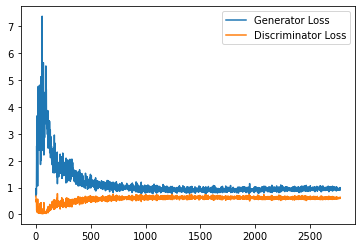

Step 56000: Generator loss: 0.9632536534070969, discriminator loss: 0.6110483667850495


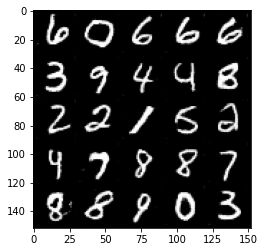

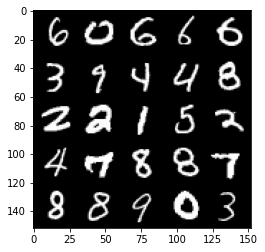

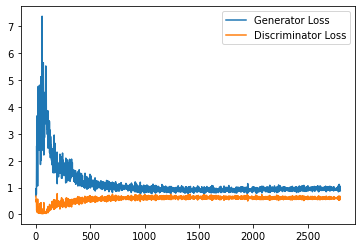

Step 56500: Generator loss: 0.9469258053302765, discriminator loss: 0.606375229716301


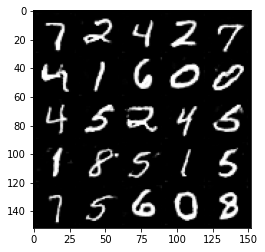

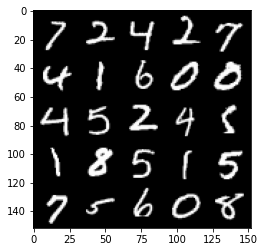

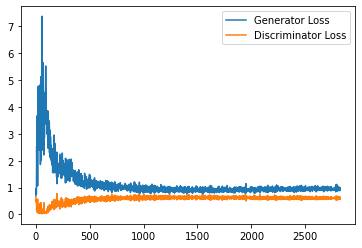

Step 57000: Generator loss: 0.9437825589179992, discriminator loss: 0.6069145085811615


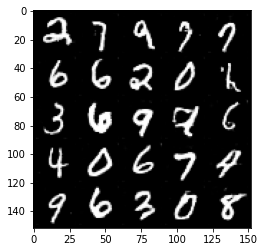

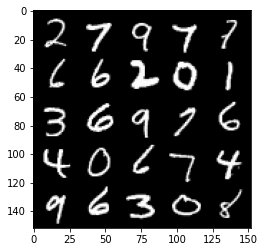

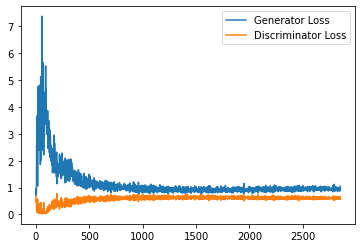

Step 57500: Generator loss: 0.9690468552112579, discriminator loss: 0.6059007558822632


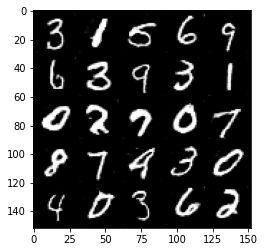

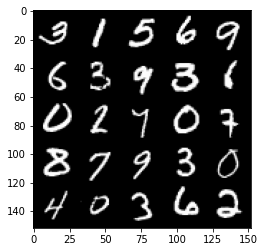

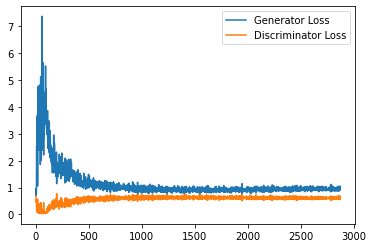

Step 58000: Generator loss: 0.9565255156755448, discriminator loss: 0.6089662717580795


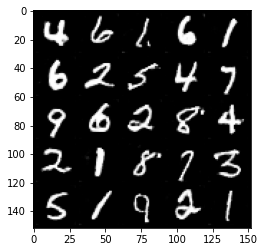

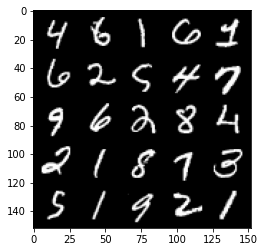

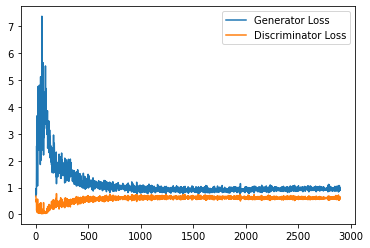

Step 58500: Generator loss: 0.9447912709712982, discriminator loss: 0.6091821591854095


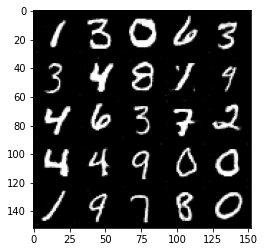

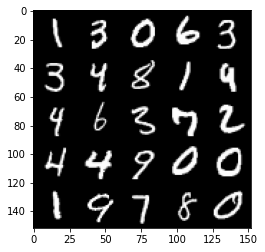

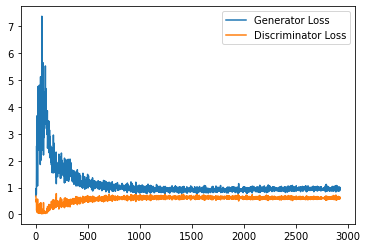

Step 59000: Generator loss: 0.9614222801923752, discriminator loss: 0.6097069645524025


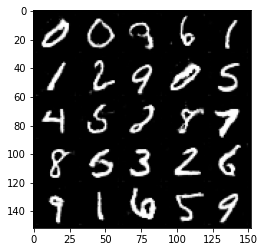

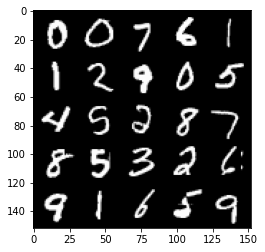

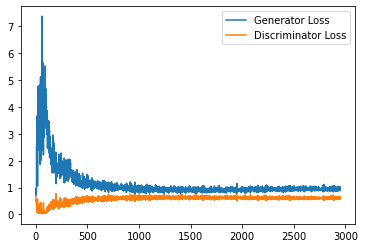

Step 59500: Generator loss: 0.9620466272830963, discriminator loss: 0.6107751697301864


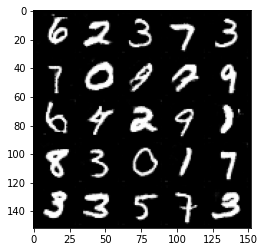

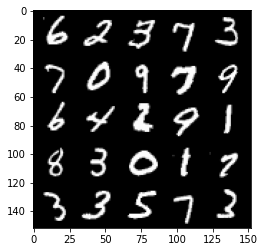

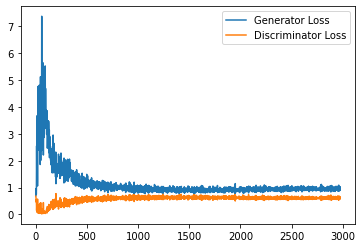

Step 60000: Generator loss: 0.9510143924951553, discriminator loss: 0.610819025337696


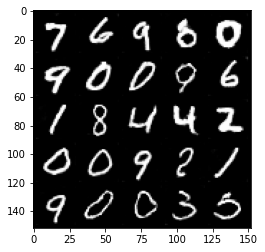

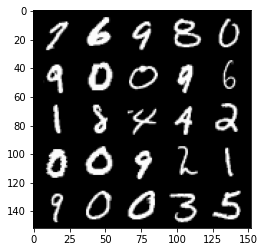

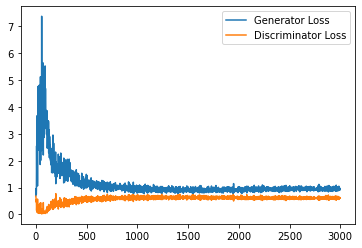

Step 60500: Generator loss: 0.9359722836017609, discriminator loss: 0.6118365380764007


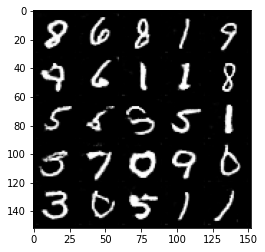

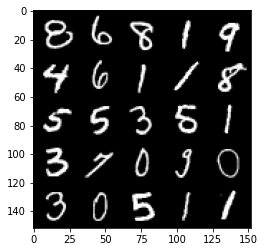

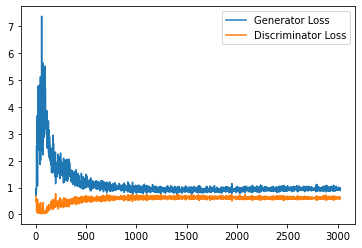

Step 61000: Generator loss: 0.9495694122314453, discriminator loss: 0.6088485736846924


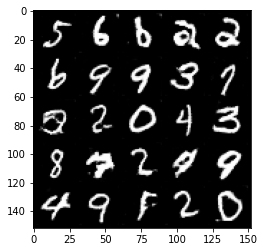

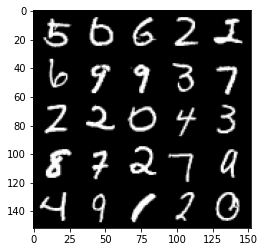

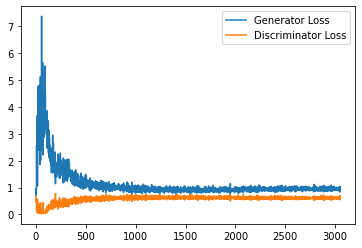

Step 61500: Generator loss: 0.9542580664157867, discriminator loss: 0.6097248044013978


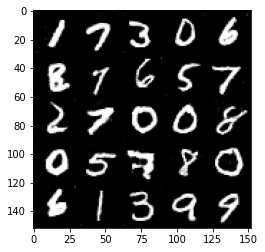

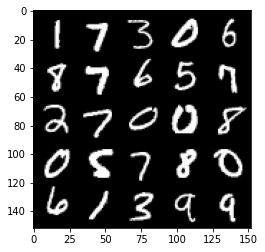

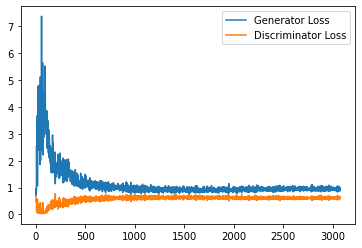

Step 62000: Generator loss: 0.9483139164447785, discriminator loss: 0.6089862988591194


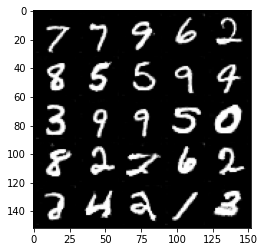

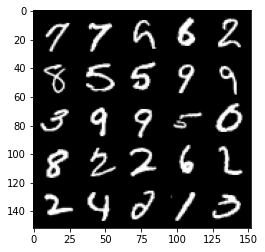

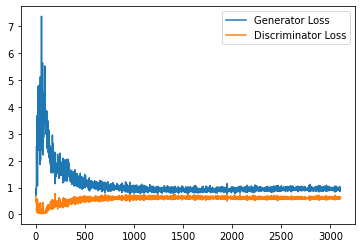

Step 62500: Generator loss: 0.9549798041582107, discriminator loss: 0.6078177634477615


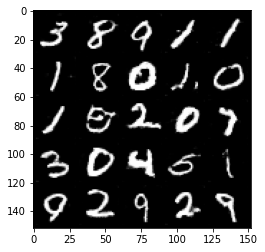

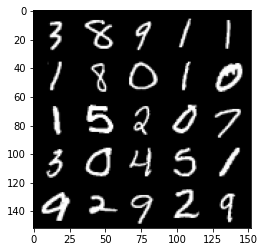

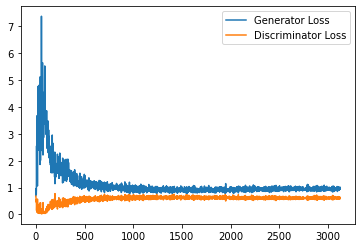

Step 63000: Generator loss: 0.9484379771947861, discriminator loss: 0.6112637189626694


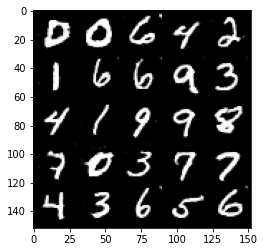

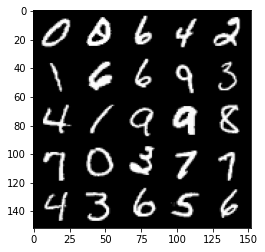

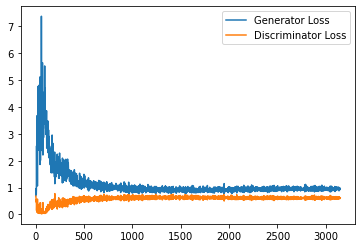

Step 63500: Generator loss: 0.9384855034351349, discriminator loss: 0.6123406811952591


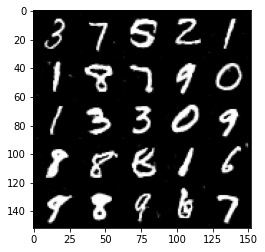

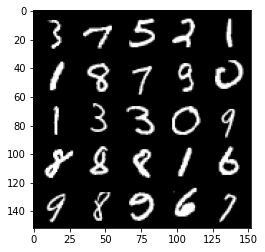

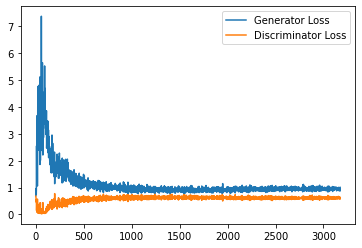

Step 64000: Generator loss: 0.950817309498787, discriminator loss: 0.6139469463229179


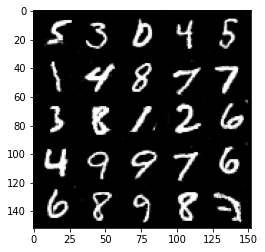

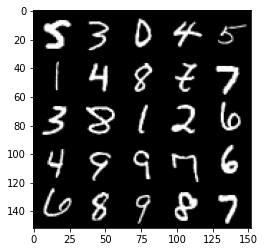

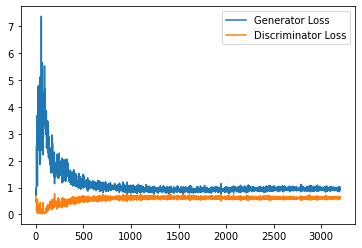

Step 64500: Generator loss: 0.9452322968244553, discriminator loss: 0.6144326034784316


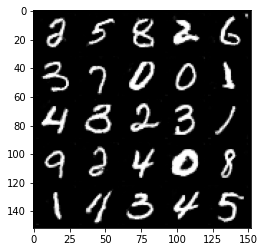

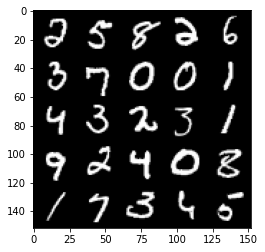

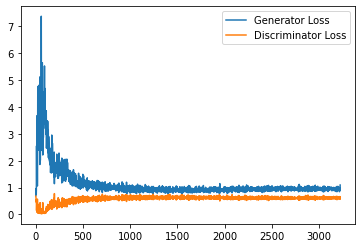

Step 65000: Generator loss: 0.9494645750522613, discriminator loss: 0.620258279144764


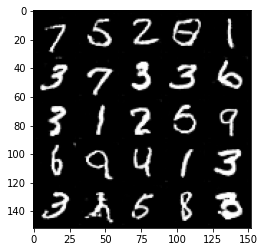

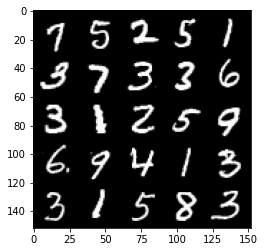

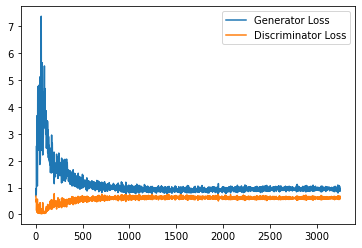

Step 65500: Generator loss: 0.9278458958864212, discriminator loss: 0.617070213675499


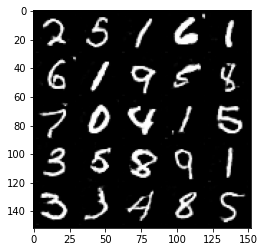

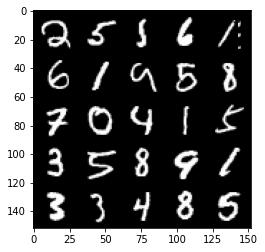

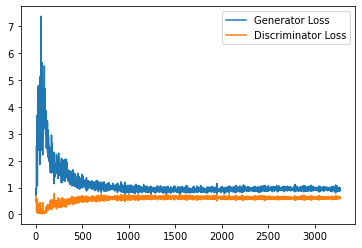

Step 66000: Generator loss: 0.9339680725336075, discriminator loss: 0.6168534792661667


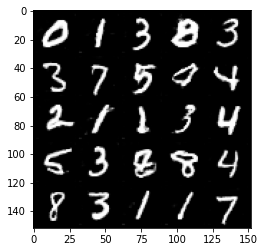

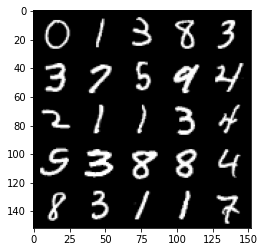

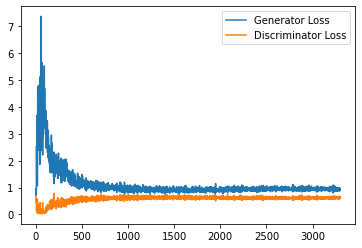

Step 66500: Generator loss: 0.9361804994344711, discriminator loss: 0.6144990346431732


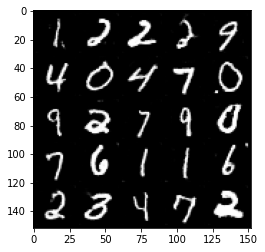

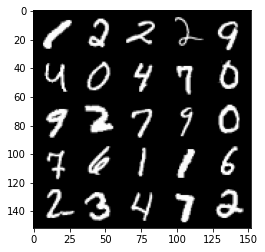

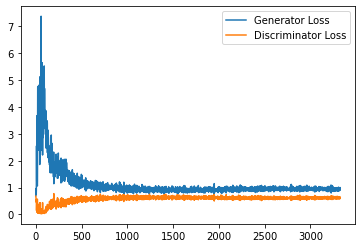

Step 67000: Generator loss: 0.9449060637950897, discriminator loss: 0.6155057094097137


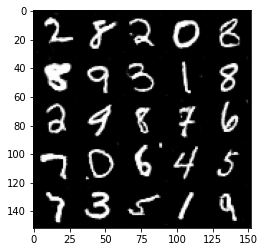

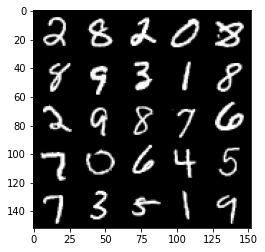

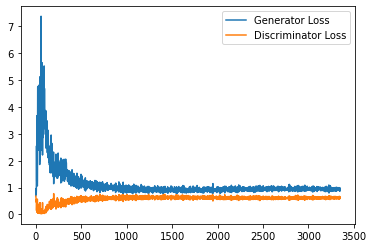

Step 67500: Generator loss: 0.9403669022321701, discriminator loss: 0.6188861246109009


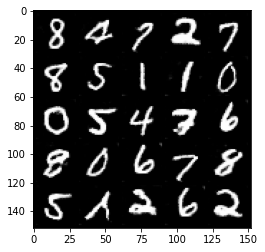

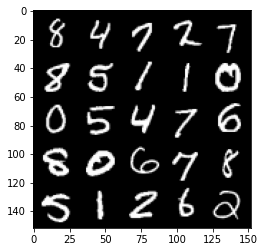

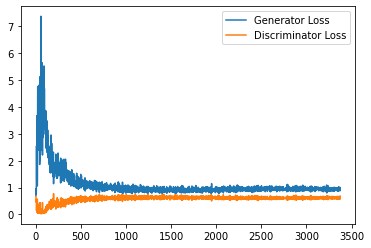

Step 68000: Generator loss: 0.9429179471731186, discriminator loss: 0.6168090130090713


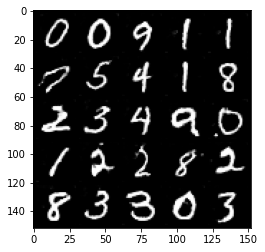

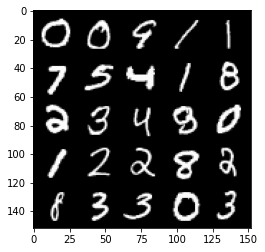

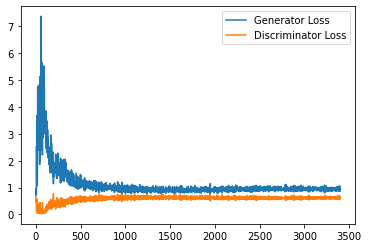

Step 68500: Generator loss: 0.935048112154007, discriminator loss: 0.6191037356853485


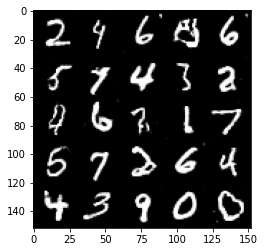

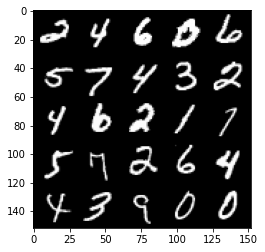

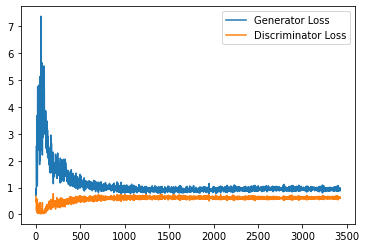

Step 69000: Generator loss: 0.9455119160413742, discriminator loss: 0.621648979306221


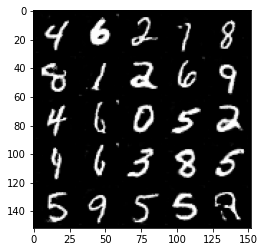

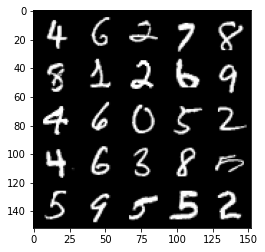

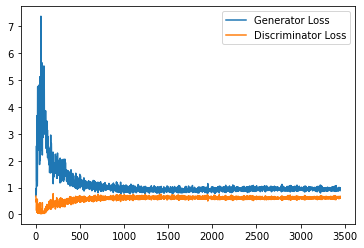

Step 69500: Generator loss: 0.9402217582464218, discriminator loss: 0.6208752285838127


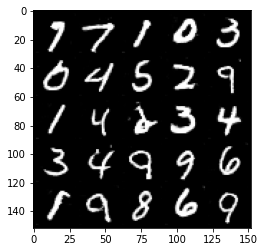

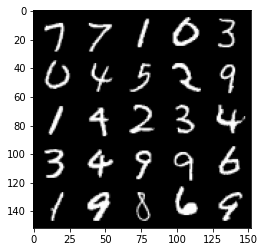

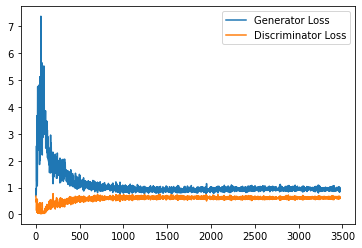

Step 70000: Generator loss: 0.9169069930315018, discriminator loss: 0.6205247637033463


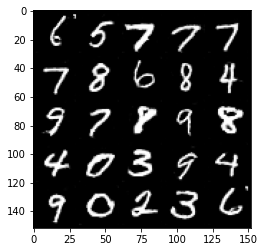

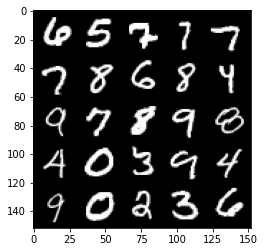

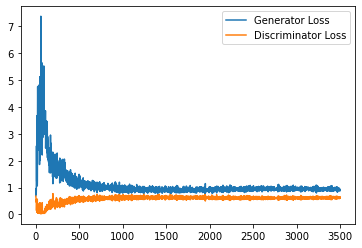

Step 70500: Generator loss: 0.9276049244403839, discriminator loss: 0.6178548108935357


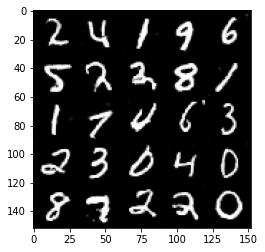

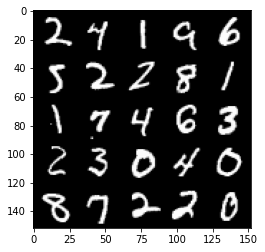

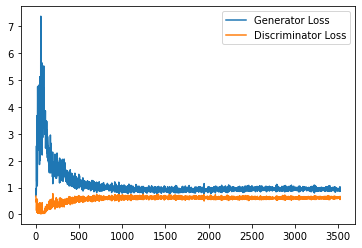

Step 71000: Generator loss: 0.9313902969360351, discriminator loss: 0.6238351916670799


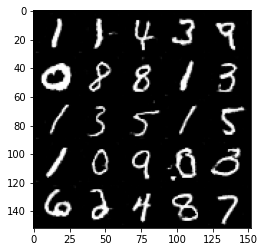

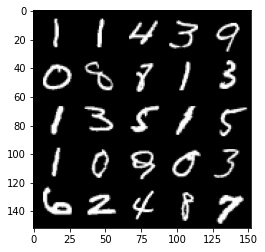

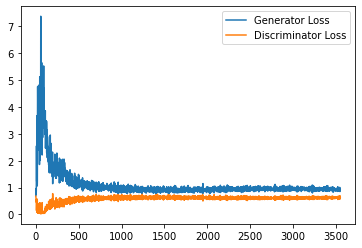

Step 71500: Generator loss: 0.9374221457242966, discriminator loss: 0.6248064604997635


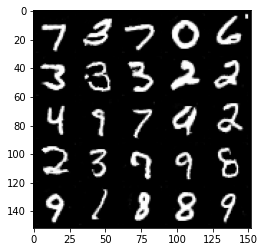

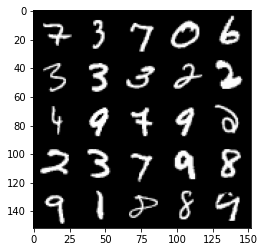

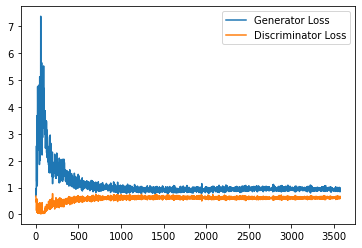

Step 72000: Generator loss: 0.9245679477453231, discriminator loss: 0.6212997229099274


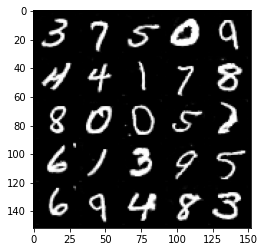

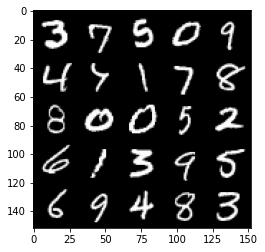

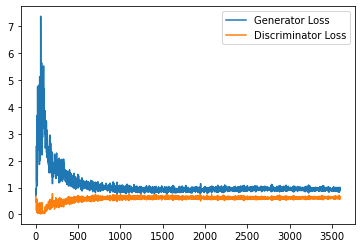

Step 72500: Generator loss: 0.9148751157522201, discriminator loss: 0.6204351409673691


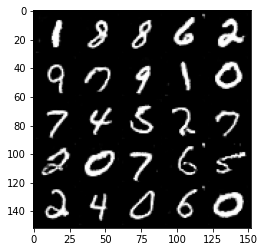

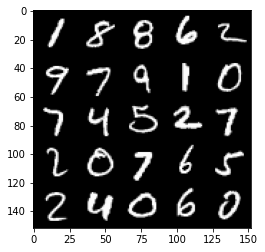

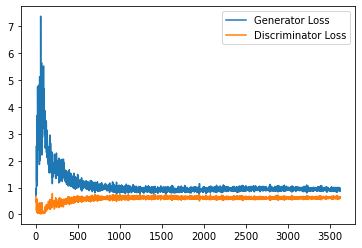

Step 73000: Generator loss: 0.9284572845697403, discriminator loss: 0.6247682324647903


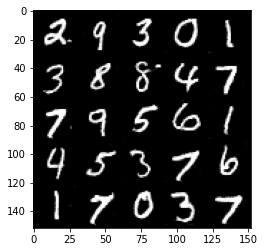

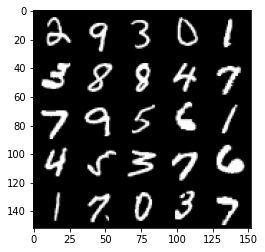

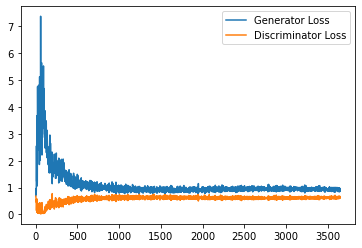

Step 73500: Generator loss: 0.9262972300052643, discriminator loss: 0.6230690990686416


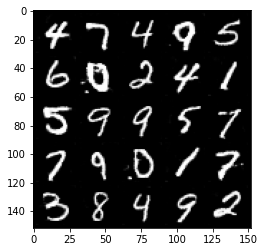

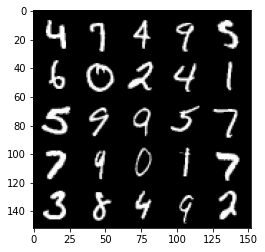

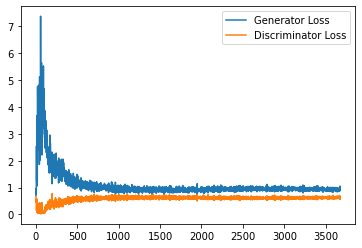

Step 74000: Generator loss: 0.9378358532190323, discriminator loss: 0.6313702995777131


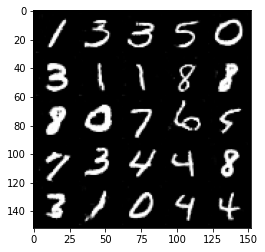

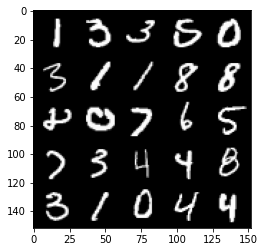

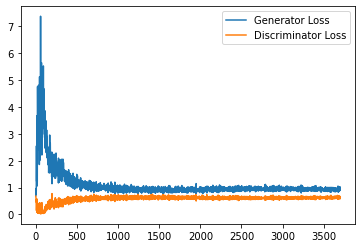

Step 74500: Generator loss: 0.9370049387216568, discriminator loss: 0.6248050428628922


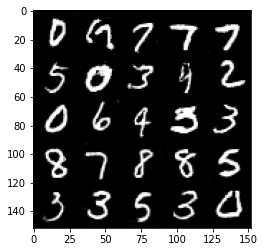

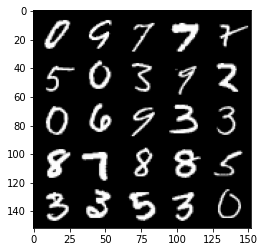

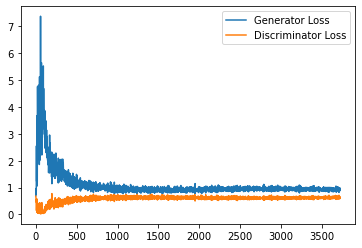

Step 75000: Generator loss: 0.9106187770366668, discriminator loss: 0.6274642295837403


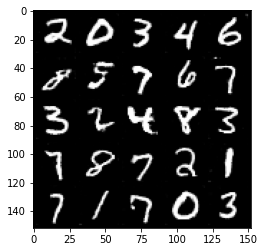

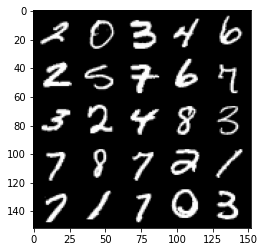

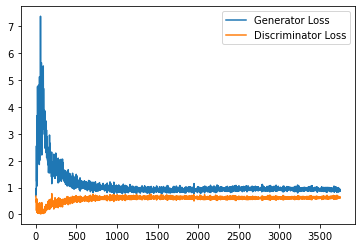

Step 75500: Generator loss: 0.9084351865053177, discriminator loss: 0.6272564896345139


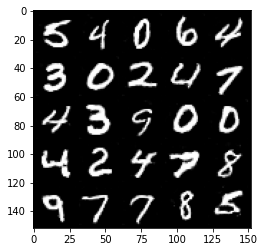

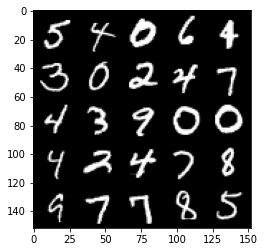

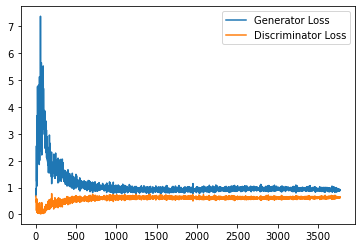

Step 76000: Generator loss: 0.9232030130624771, discriminator loss: 0.626836531996727


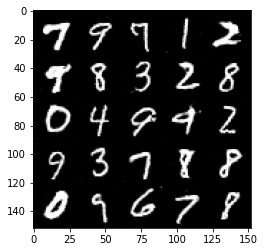

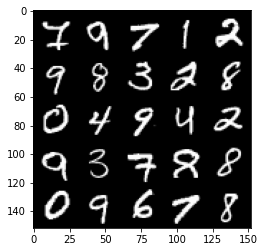

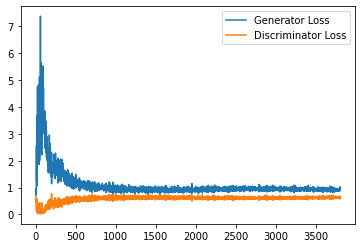

Step 76500: Generator loss: 0.9286909736394883, discriminator loss: 0.6299029823541641


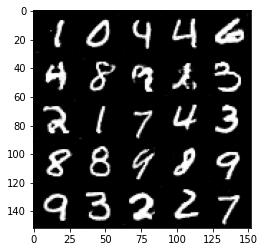

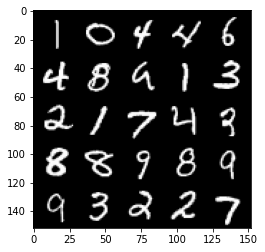

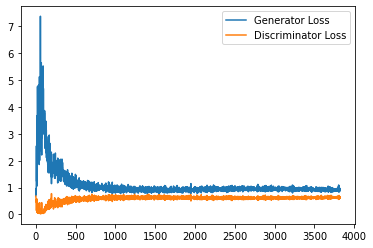

Step 77000: Generator loss: 0.9079404988288879, discriminator loss: 0.6266271605491638


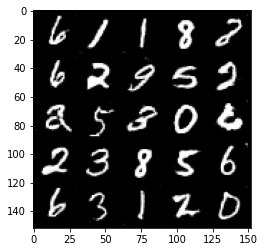

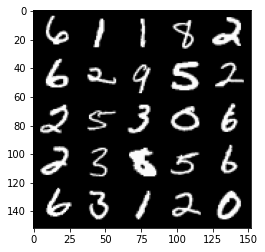

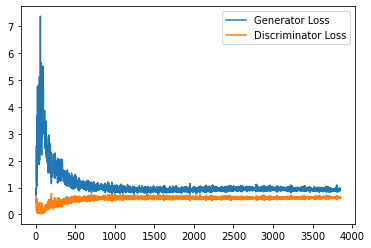

Step 77500: Generator loss: 0.9109996733665466, discriminator loss: 0.624263034582138


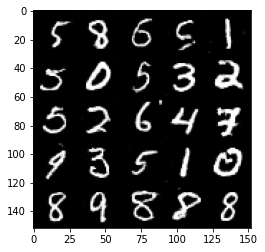

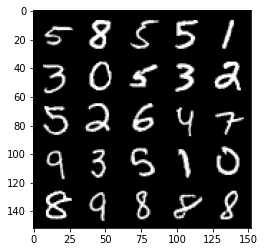

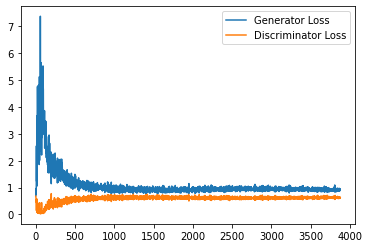

Step 78000: Generator loss: 0.917367250919342, discriminator loss: 0.6277086011171341


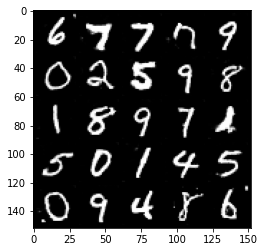

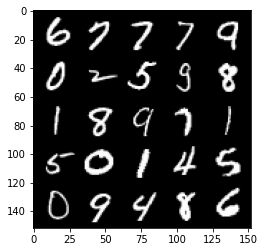

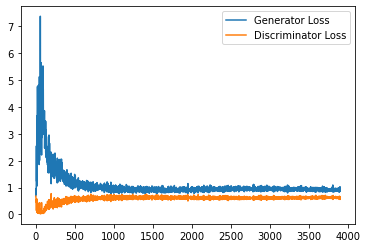

Step 78500: Generator loss: 0.9109911125898361, discriminator loss: 0.6287329124212265


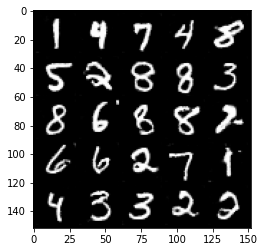

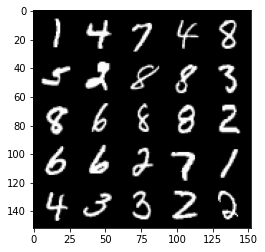

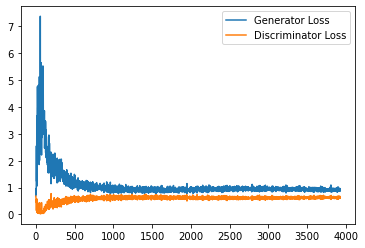

Step 79000: Generator loss: 0.91764362347126, discriminator loss: 0.6262225320339203


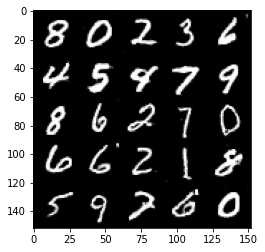

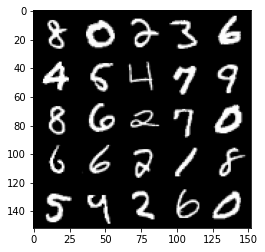

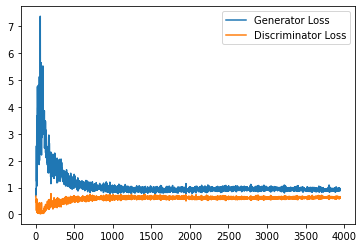

Step 79500: Generator loss: 0.9390272061824798, discriminator loss: 0.6253225618600845


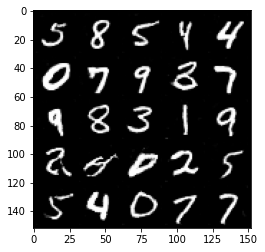

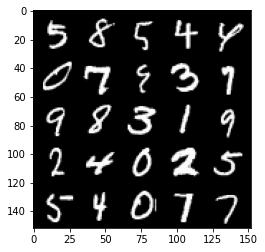

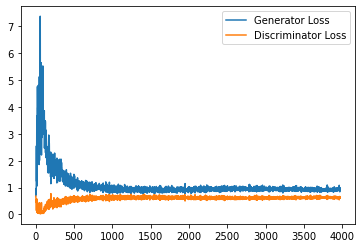

Step 80000: Generator loss: 0.9256065975427628, discriminator loss: 0.6310337448120117


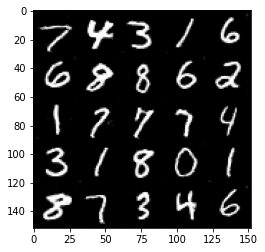

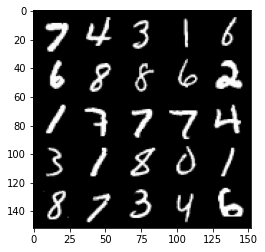

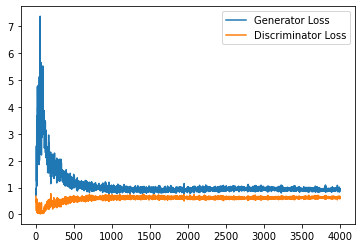

Step 80500: Generator loss: 0.9184672485589981, discriminator loss: 0.6279799598455429


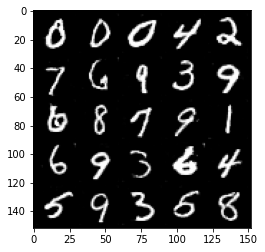

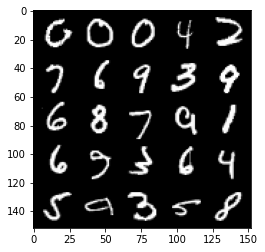

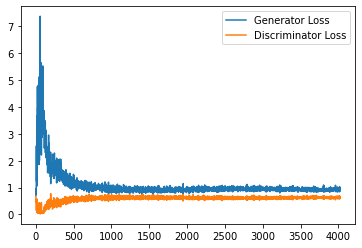

Step 81000: Generator loss: 0.8987910684347152, discriminator loss: 0.6308775631189346


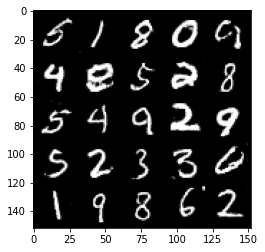

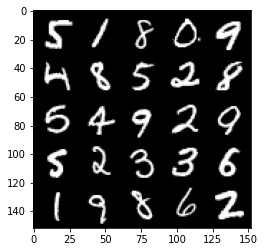

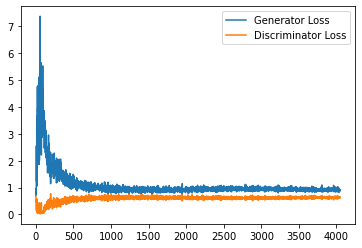

Step 81500: Generator loss: 0.9106689915657044, discriminator loss: 0.6273676271438599


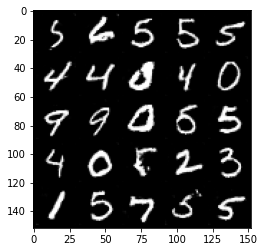

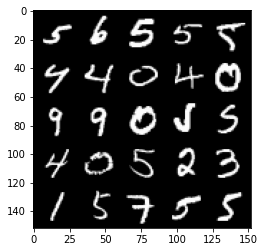

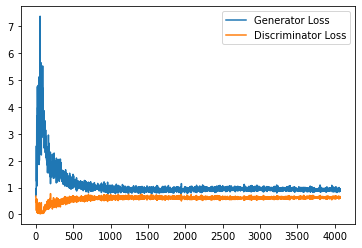

Step 82000: Generator loss: 0.9247972202301026, discriminator loss: 0.6281598341464997


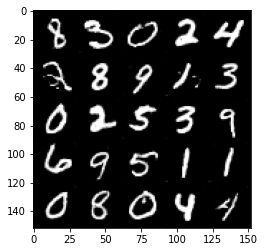

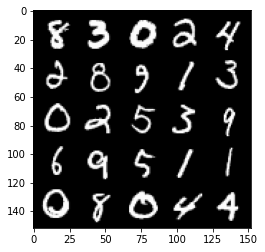

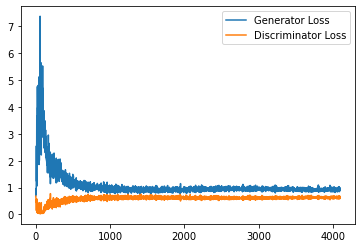

Step 82500: Generator loss: 0.9033051137924194, discriminator loss: 0.6313043870925903


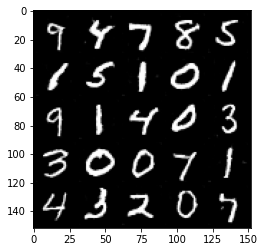

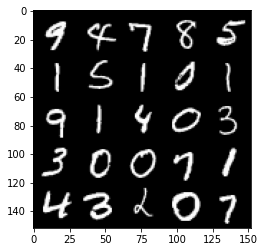

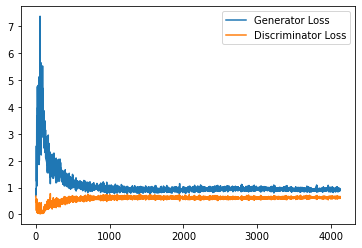

Step 83000: Generator loss: 0.9048822495937348, discriminator loss: 0.6282938731908798


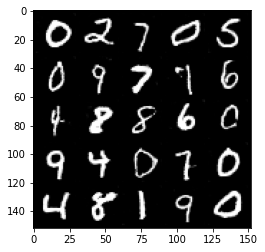

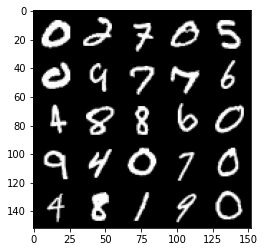

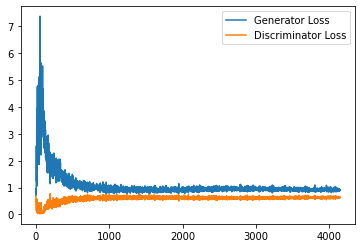

Step 83500: Generator loss: 0.9052088475227356, discriminator loss: 0.6269351469278336


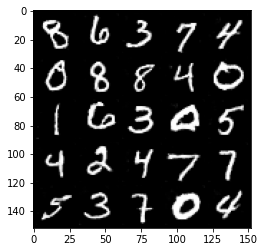

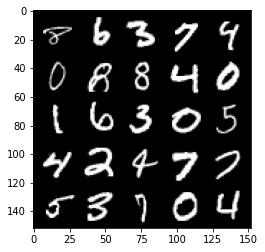

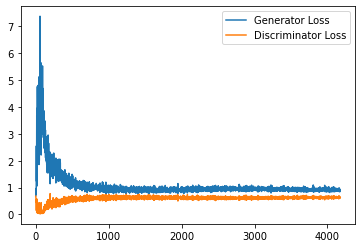

Step 84000: Generator loss: 0.9121981792449951, discriminator loss: 0.629559883594513


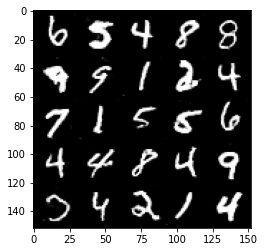

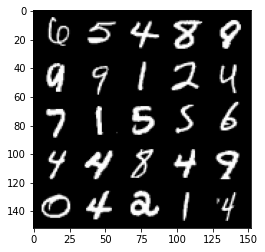

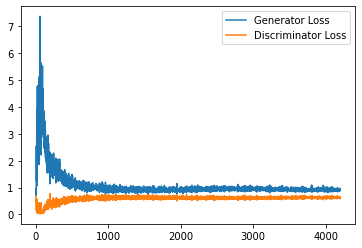

Step 84500: Generator loss: 0.9075922137498855, discriminator loss: 0.6321308006048203


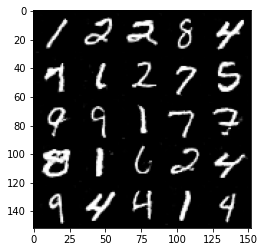

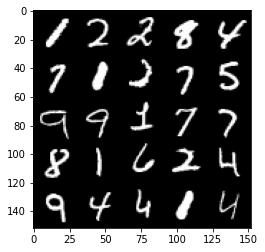

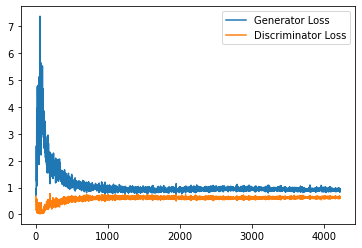

Step 85000: Generator loss: 0.9016162611246109, discriminator loss: 0.6318135868310928


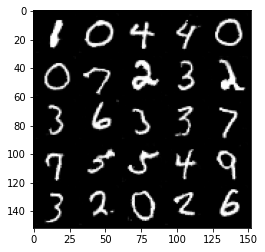

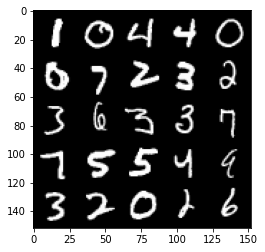

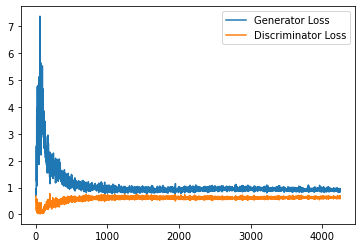

Step 85500: Generator loss: 0.9142045384645462, discriminator loss: 0.6306128461956978


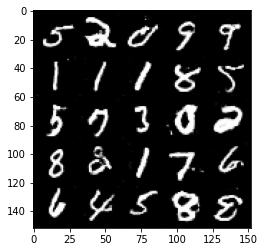

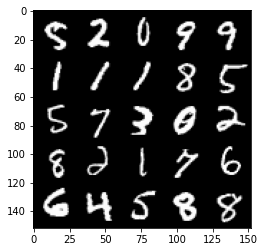

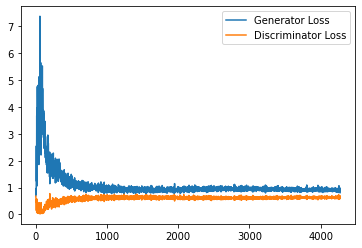

Step 86000: Generator loss: 0.893097626209259, discriminator loss: 0.6301519145965576


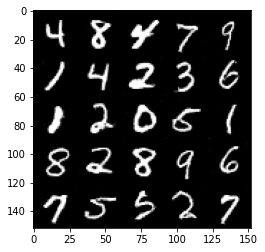

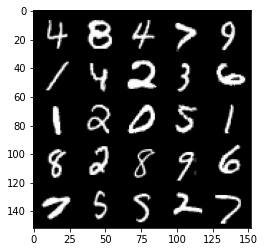

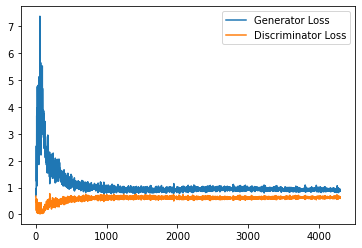

Step 86500: Generator loss: 0.914262209057808, discriminator loss: 0.6312887767553329


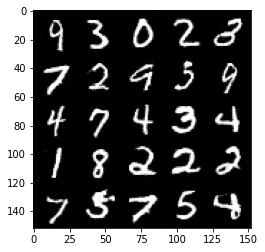

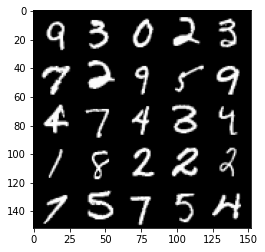

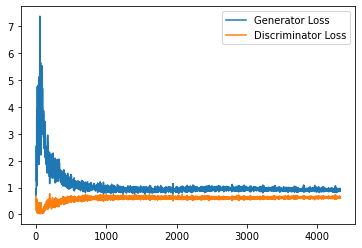

Step 87000: Generator loss: 0.9032661417722702, discriminator loss: 0.6325286791324616


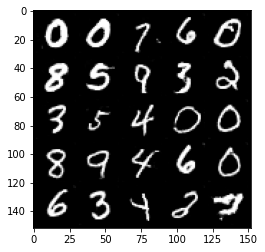

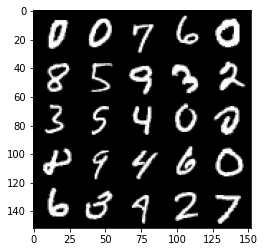

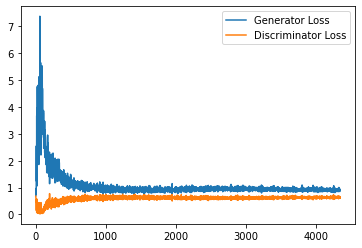

Step 87500: Generator loss: 0.8924341560602188, discriminator loss: 0.6278835580348968


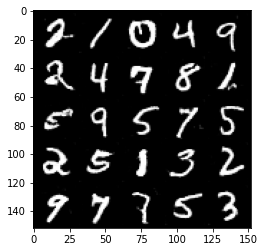

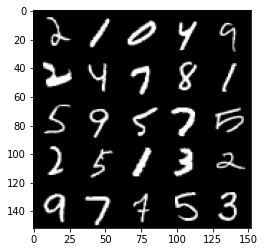

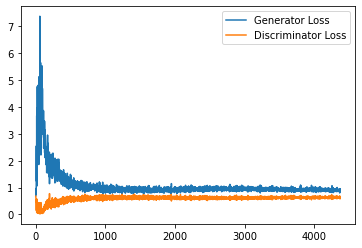

Step 88000: Generator loss: 0.9058073662519455, discriminator loss: 0.631572021484375


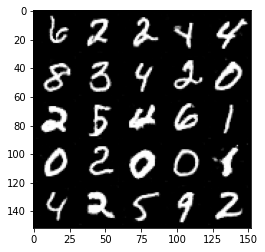

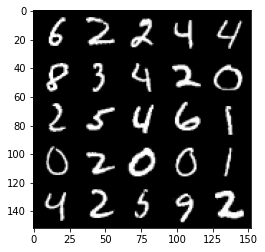

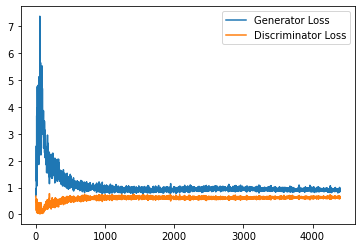

Step 88500: Generator loss: 0.8988493025302887, discriminator loss: 0.6334521824121475


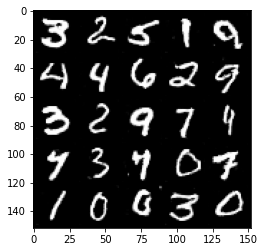

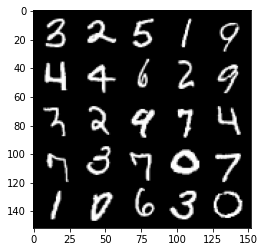

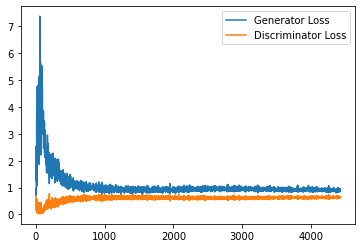

Step 89000: Generator loss: 0.8982922016382218, discriminator loss: 0.6356917637586593


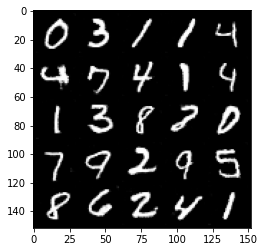

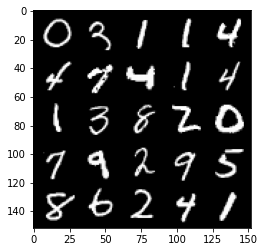

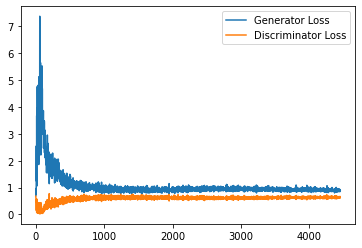

Step 89500: Generator loss: 0.8952283005714416, discriminator loss: 0.6316927505731582


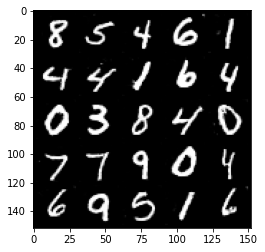

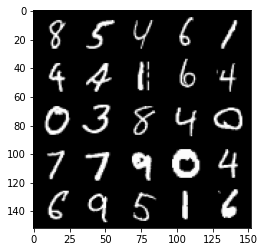

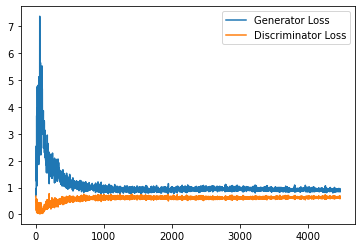

Step 90000: Generator loss: 0.9183031141757965, discriminator loss: 0.632170331120491


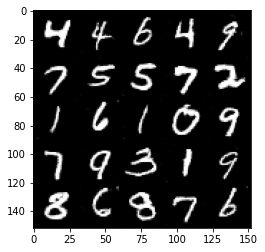

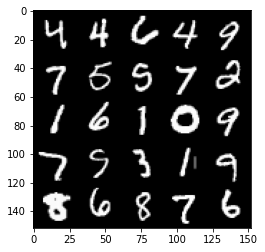

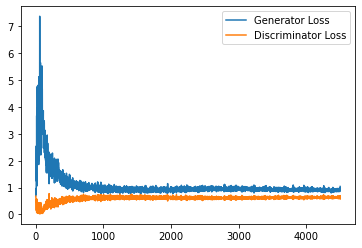

Step 90500: Generator loss: 0.9054566866159439, discriminator loss: 0.6330634075403213


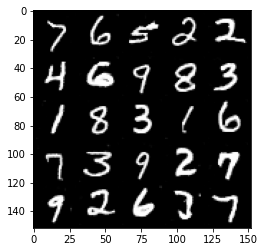

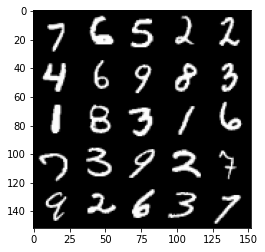

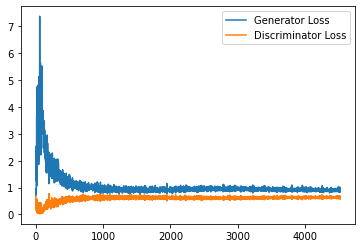

Step 91000: Generator loss: 0.888410990357399, discriminator loss: 0.6374705188274383


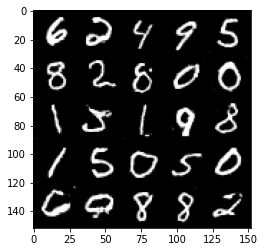

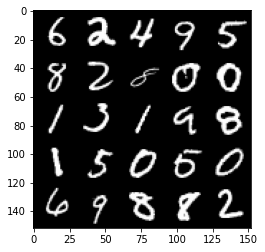

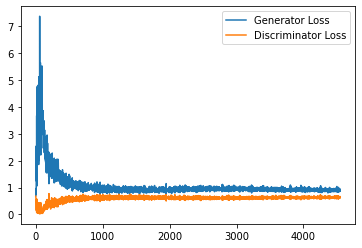

Step 91500: Generator loss: 0.9082222229242325, discriminator loss: 0.6315646802186966


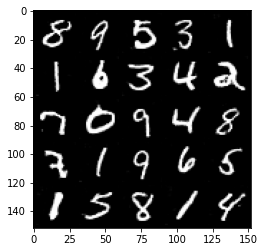

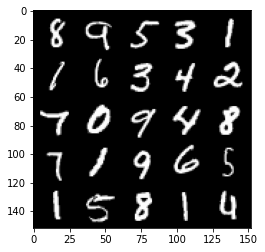

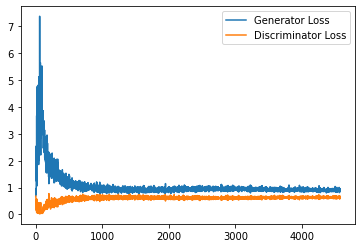

Step 92000: Generator loss: 0.8936638596057892, discriminator loss: 0.6363691834211349


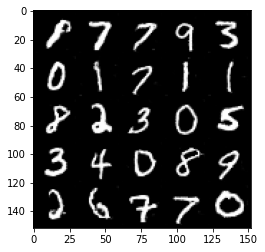

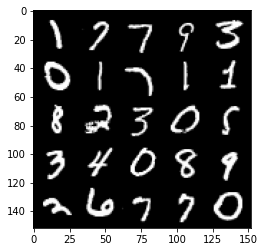

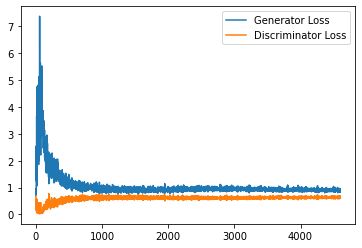

Step 92500: Generator loss: 0.9018978259563446, discriminator loss: 0.6349292435646057


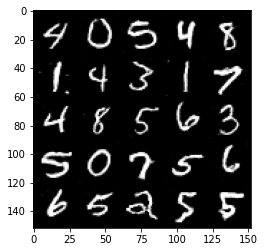

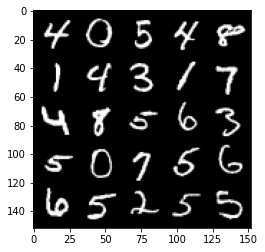

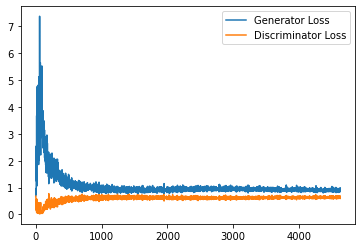

Step 93000: Generator loss: 0.9049671322107316, discriminator loss: 0.6362335767149925


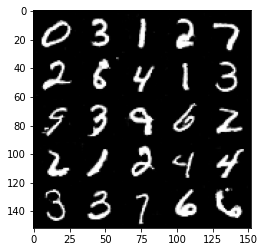

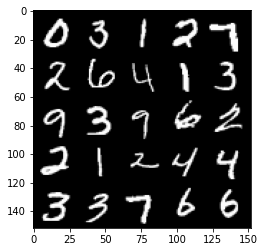

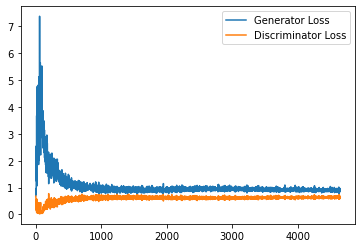

Step 93500: Generator loss: 0.9015556145906448, discriminator loss: 0.635514173746109


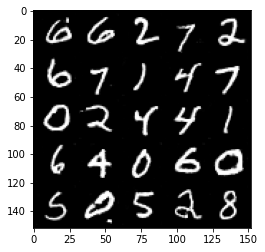

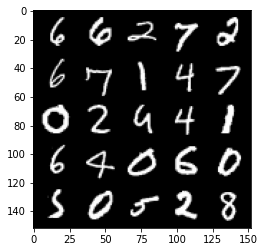

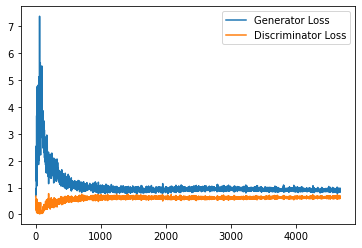

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

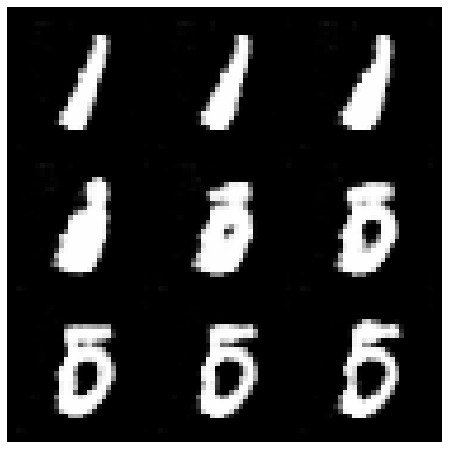

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

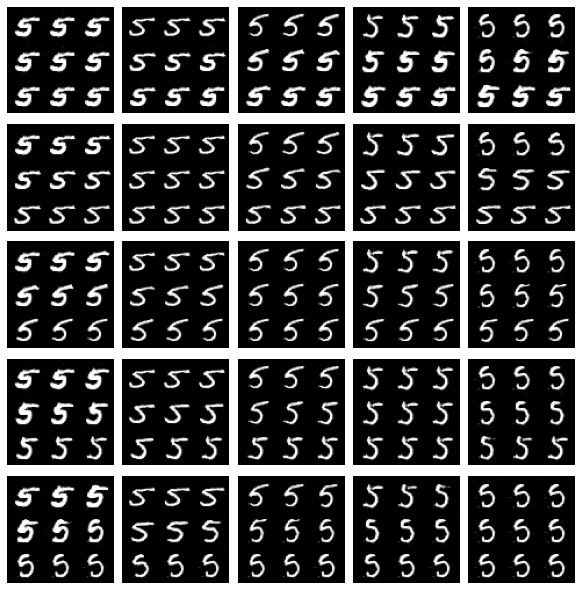

In [16]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()